In [11]:
import torch
import torch.nn as nn
import torch.optim as optim
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import random

class ResidualBlock(nn.Module):
    def __init__(self, input_dim):
        super(ResidualBlock, self).__init__()
        self.fc = nn.Linear(input_dim, input_dim)
        self.layer_norm = nn.LayerNorm(input_dim)
        self.activation = nn.ReLU()

    def forward(self, x):
        identity = x
        out = self.fc(x)
        out = self.layer_norm(out)
        '''out = self.fc(x)
        out = self.layer_norm(out)'''
        out = self.fc(out)
        out = self.activation(out)
        out = out + identity  # Adding the input back to the output
        return out

class VAE(nn.Module):
    def __init__(self, input_dim, hidden_dims, latent_dim):
        super(VAE, self).__init__()
        # Encoder with residual blocks
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout(0.2),
            nn.Linear(hidden_dims, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout(0.2),
            ResidualBlock(hidden_dims),
            nn.Linear(hidden_dims, hidden_dims),
            nn.Dropout(0.2),
            nn.ReLU(),
            ResidualBlock (hidden_dims),
            nn.Linear (hidden_dims, hidden_dims),
            nn.ReLU()
        )
        self.fc_mu = nn.Linear(hidden_dims, latent_dim)
        self.fc_log_var = nn.Linear(hidden_dims, latent_dim)

        # Decoder with residual blocks
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout(0.2),
            nn.Linear(hidden_dims, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout(0.2),
            nn.Linear(hidden_dims, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Linear(hidden_dims, hidden_dims),
            nn.ReLU(),
            ResidualBlock(hidden_dims),
            nn.Dropout (0.2),
            nn.Linear (hidden_dims, input_dim),
            nn.Sigmoid()
        )

    def encode(self, x):
        h = self.encoder(x)
        mu = self.fc_mu(h)
        log_var = self.fc_log_var(h)
        return mu, log_var

    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        mu, log_var = self.encode(x.view(-1, num_nodes * 2))
        z = self.reparameterize(mu, log_var)
        return self.decode(z), mu, log_var

def loss_function(recon_x, x, mu, log_var):
    recon_loss = nn.functional.mse_loss(recon_x, x.view(-1, num_nodes * 2), reduction='sum')
    kld_loss = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
    return recon_loss + kld_loss

def plot_graph(ax, G, pos):
    #plt.figure(figsize=(6, 6))
    nx.draw(G, pos, with_labels=False, node_color = range (num_nodes), cmap = plt.cm.tab20b, edge_color='k',
           node_size = 50, ax = ax)
       
    #plt.show()
    
def optimize_layout(G, initial_pos):
    # Use a spring layout to optimize positions
    optimized_pos = nx.spring_layout(G, pos=initial_pos, iterations = 50)
    return optimized_pos

In [12]:
def train(model, optimizer, data, epochs = 10):
    model.train()
    loss = None
    for epoch in range(epochs):
        optimizer.zero_grad()
        recon_batch, mu, log_var = model(data)
        loss = loss_function(recon_batch, data, mu, log_var)
        loss.backward()
        optimizer.step()
    print (loss)


In [13]:
def calculate_aesthetic_metrics(positions, edges, min_dist=0.05):
    edge_lengths = torch.stack([torch.norm(positions[e[0]] - positions[e[1]], p=2) for e in edges])
    edge_length_variance = torch.var(edge_lengths)
    node_overlap_count = 0
    n = positions.size(0)
    for i in range(n):
        for j in range(i + 1, n):
            distance = torch.norm(positions[i] - positions[j], p=2)
            if distance < min_dist:
                node_overlap_count += 1
    return edge_length_variance.item(), node_overlap_count

tensor(0.6549, grad_fn=<AddBackward0>)


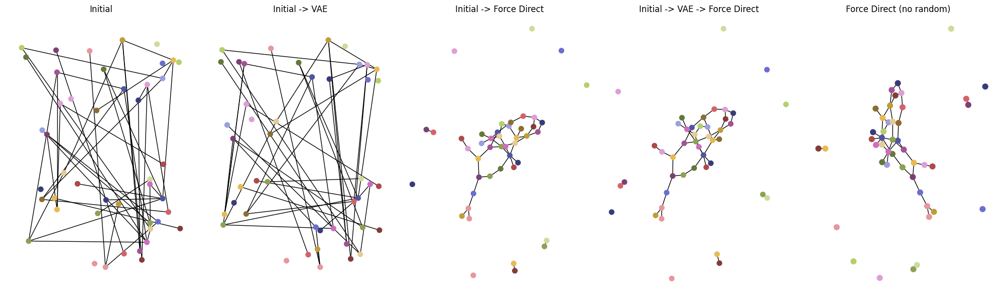

Initial->Force: (0.0008812867736781541, 4)
Model (0.0008626329899767375, 0)
Force Only (0.0008406085760083603, 2)
tensor(0.7622, grad_fn=<AddBackward0>)


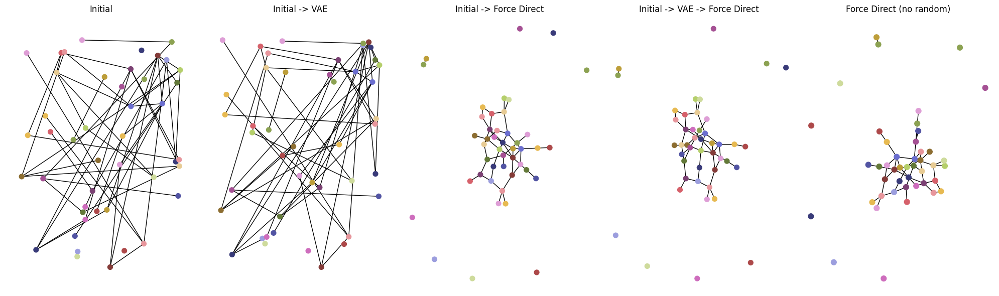

Initial->Force: (0.0008872399962348928, 2)
Model (0.0008442330344527639, 2)
Force Only (0.0011978652053539695, 1)
tensor(0.7688, grad_fn=<AddBackward0>)


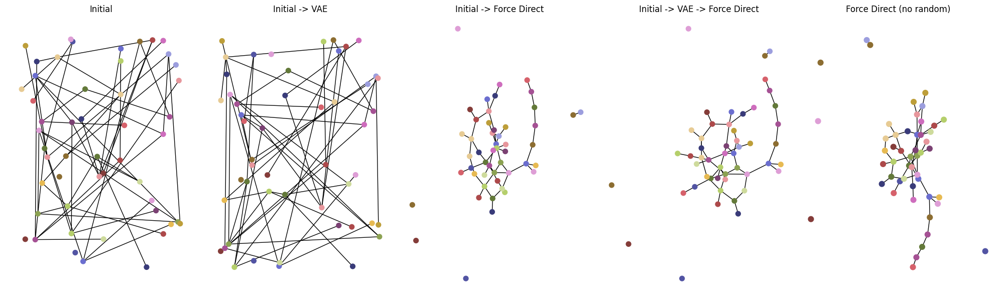

Initial->Force: (0.0007847729432342448, 5)
Model (0.001050135530081149, 2)
Force Only (0.0010803408295490702, 6)
tensor(0.7255, grad_fn=<AddBackward0>)


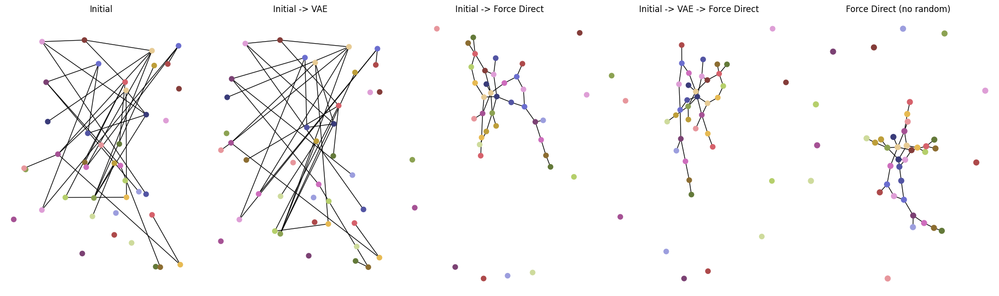

Initial->Force: (0.0006664764484443323, 1)
Model (0.0007249325731574016, 2)
Force Only (0.0009409055821059334, 1)
tensor(0.7227, grad_fn=<AddBackward0>)


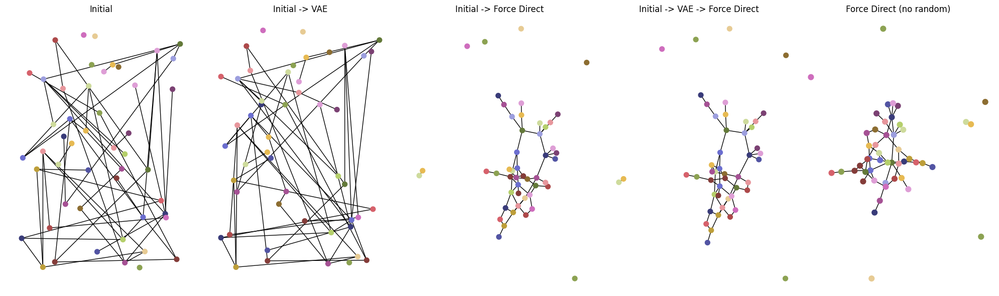

Initial->Force: (0.0012878959049045136, 8)
Model (0.0012740829934406507, 8)
Force Only (0.0010632139489122501, 3)
tensor(0.8138, grad_fn=<AddBackward0>)


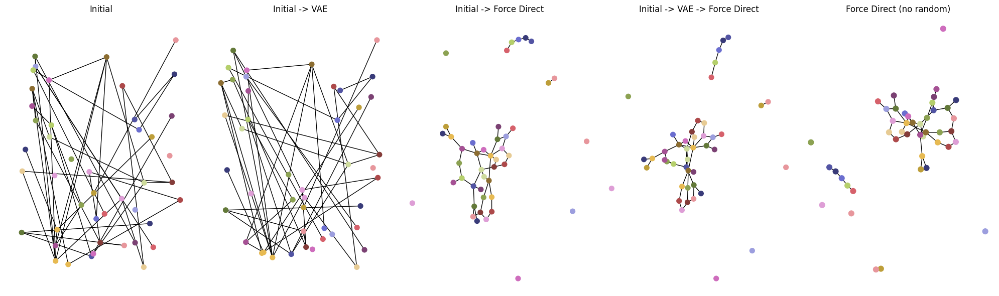

Initial->Force: (0.0009327581304573213, 0)
Model (0.0009275268616110478, 3)
Force Only (0.0013251014837916528, 4)
tensor(0.7955, grad_fn=<AddBackward0>)


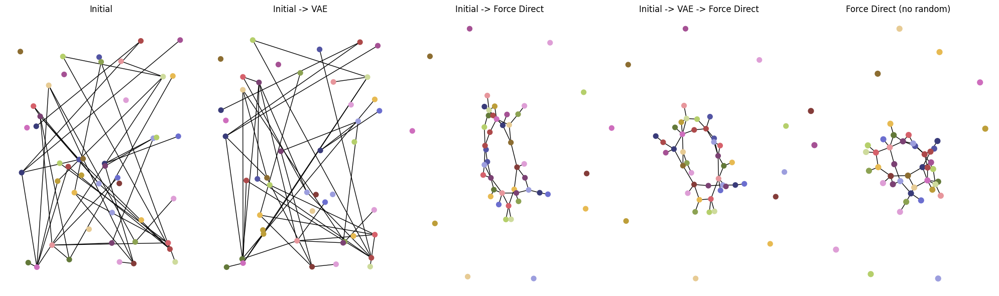

Initial->Force: (0.0009172428769652607, 6)
Model (0.0009158831127248526, 4)
Force Only (0.0006270762940277819, 5)
tensor(0.9327, grad_fn=<AddBackward0>)


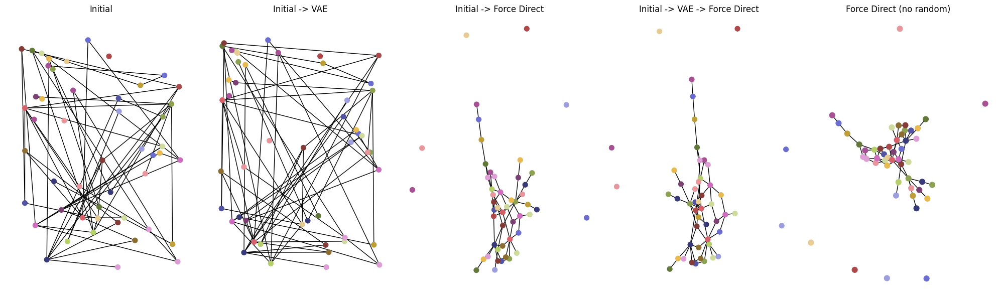

Initial->Force: (0.0009353678309863357, 10)
Model (0.0010447553509664801, 9)
Force Only (0.0012931519818176094, 10)
tensor(0.9476, grad_fn=<AddBackward0>)


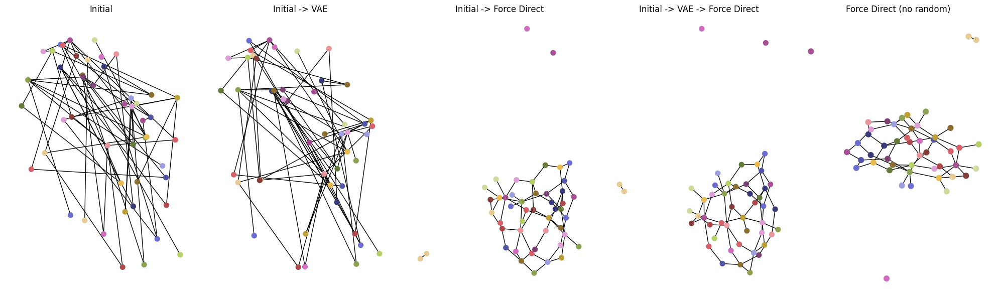

Initial->Force: (0.0010286197209713422, 6)
Model (0.0009577125972863278, 3)
Force Only (0.0007233836409274704, 11)
tensor(0.6323, grad_fn=<AddBackward0>)


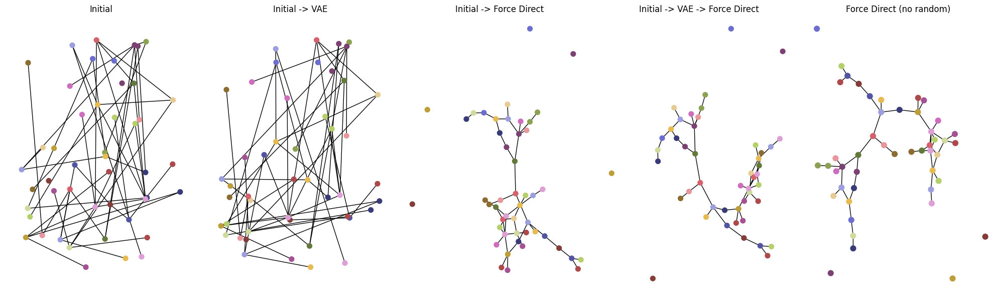

Initial->Force: (0.0011218569763816702, 3)
Model (0.001609206562533987, 4)
Force Only (0.0013255199958964407, 1)
tensor(0.5458, grad_fn=<AddBackward0>)


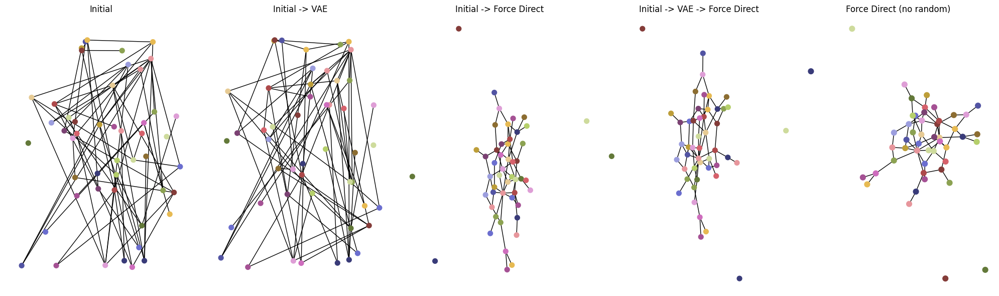

Initial->Force: (0.0007189840798454859, 7)
Model (0.0010379409047927132, 7)
Force Only (0.0008390749683398274, 7)
tensor(0.7448, grad_fn=<AddBackward0>)


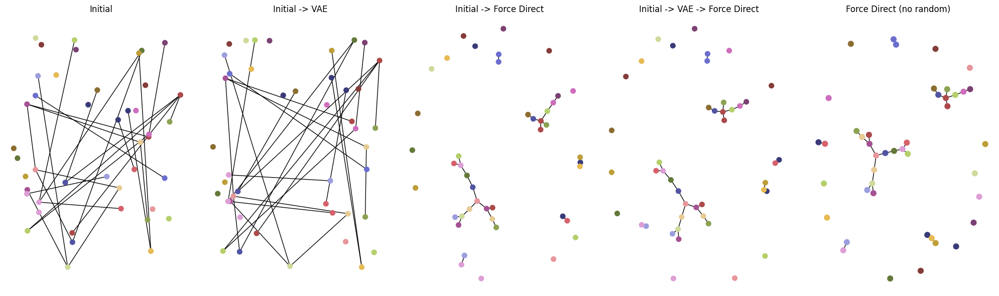

Initial->Force: (0.0004616585008314097, 2)
Model (0.0006445389421382662, 1)
Force Only (0.00039348548099605766, 0)
tensor(0.7337, grad_fn=<AddBackward0>)


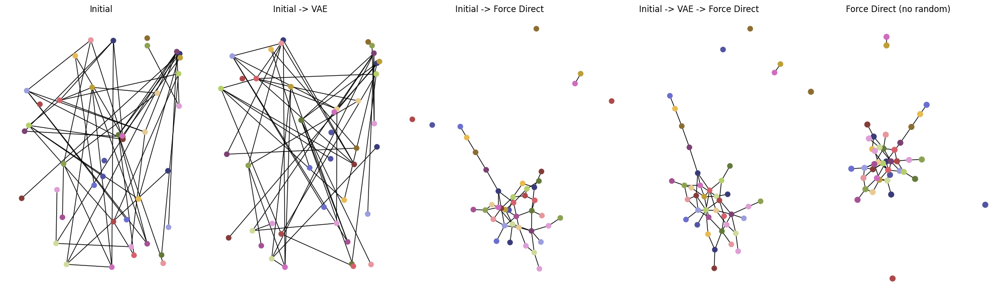

Initial->Force: (0.0008957417708640854, 5)
Model (0.0007620617003592031, 1)
Force Only (0.0010026474851892355, 11)
tensor(0.9151, grad_fn=<AddBackward0>)


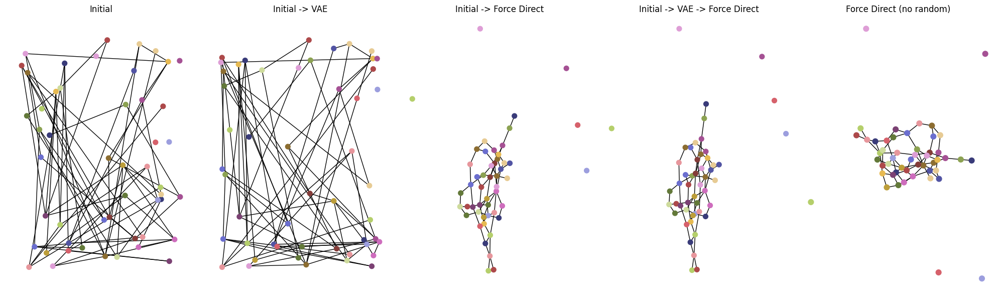

Initial->Force: (0.0008307651945982958, 9)
Model (0.0008801468626814459, 5)
Force Only (0.0008735104098472117, 5)
tensor(0.6309, grad_fn=<AddBackward0>)


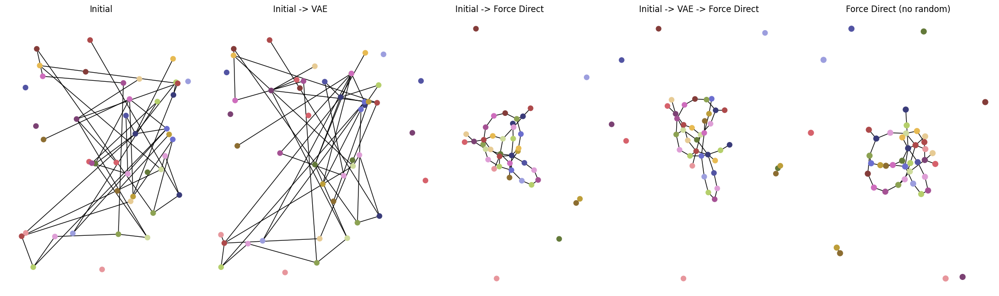

Initial->Force: (0.0006795796639006072, 5)
Model (0.0006540081943504626, 5)
Force Only (0.0010915573866048824, 1)
tensor(0.7585, grad_fn=<AddBackward0>)


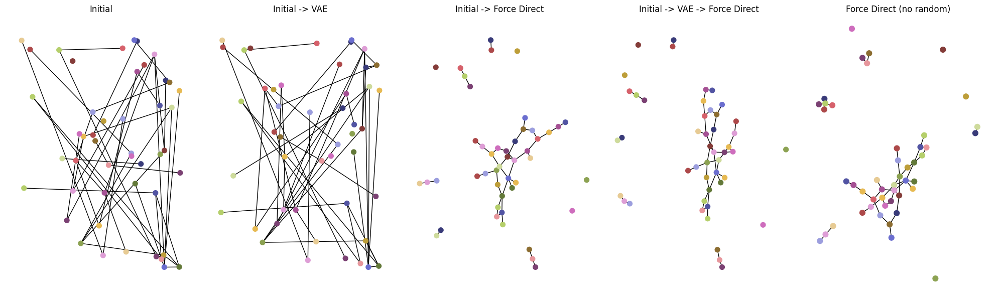

Initial->Force: (0.0009584597885302703, 1)
Model (0.0011121693584284571, 0)
Force Only (0.0007880334504228523, 4)
tensor(0.8607, grad_fn=<AddBackward0>)


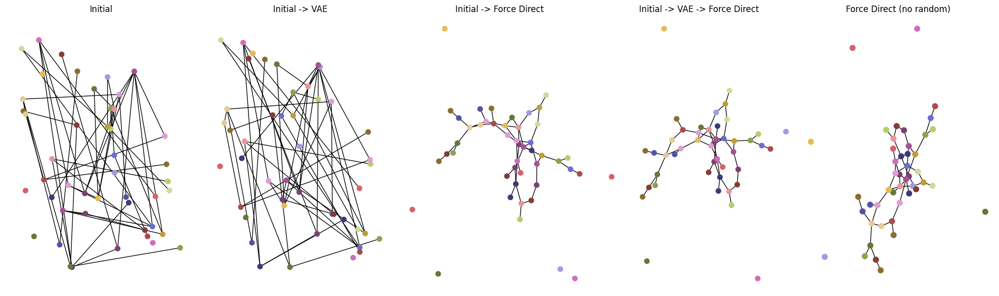

Initial->Force: (0.0011124501606078316, 2)
Model (0.001106099106462263, 4)
Force Only (0.0010471814983195667, 3)
tensor(0.6813, grad_fn=<AddBackward0>)


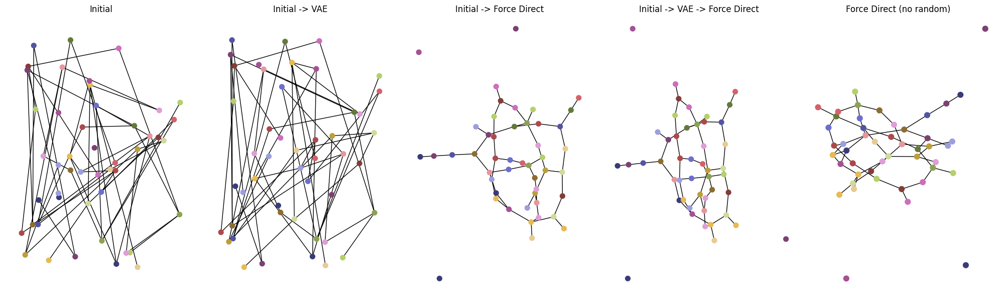

Initial->Force: (0.0017238171692070218, 3)
Model (0.0013558448627921283, 5)
Force Only (0.0009038113720564238, 6)
tensor(0.5523, grad_fn=<AddBackward0>)


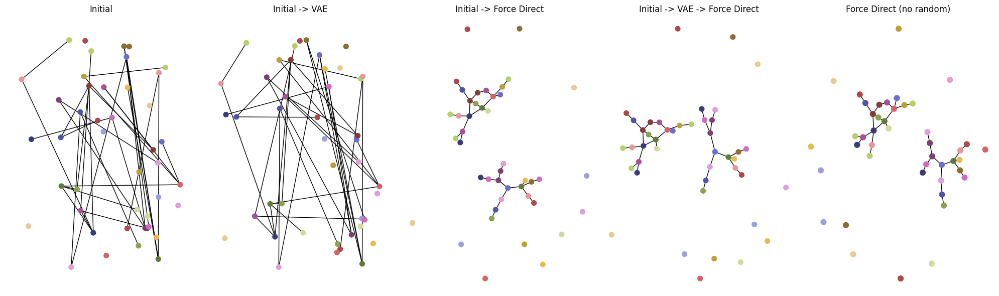

Initial->Force: (0.0006001286726389179, 0)
Model (0.000621863762686776, 0)
Force Only (0.000437516146156527, 0)
tensor(0.8129, grad_fn=<AddBackward0>)


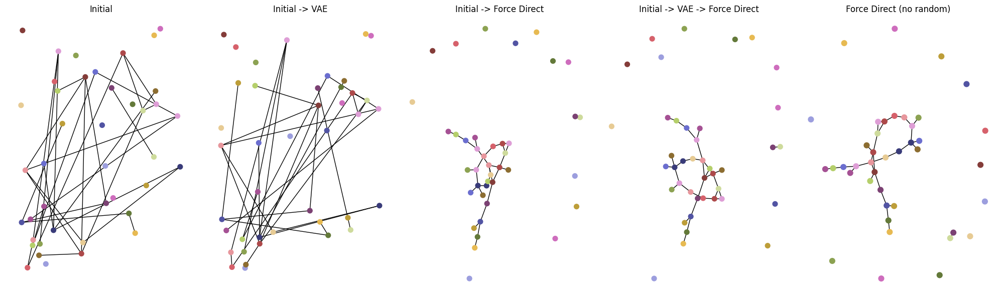

Initial->Force: (0.0010740665870891115, 1)
Model (0.0007279445623667016, 0)
Force Only (0.0009767750638431912, 0)
tensor(0.5801, grad_fn=<AddBackward0>)


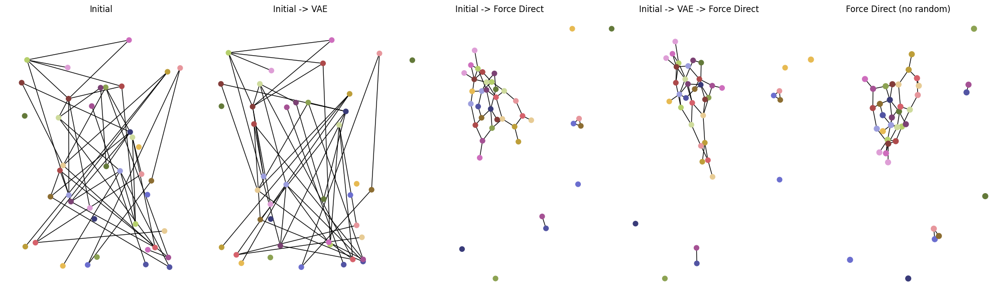

Initial->Force: (0.0008065510639282439, 3)
Model (0.0009059134049727093, 5)
Force Only (0.0009979462570611963, 4)
tensor(0.6607, grad_fn=<AddBackward0>)


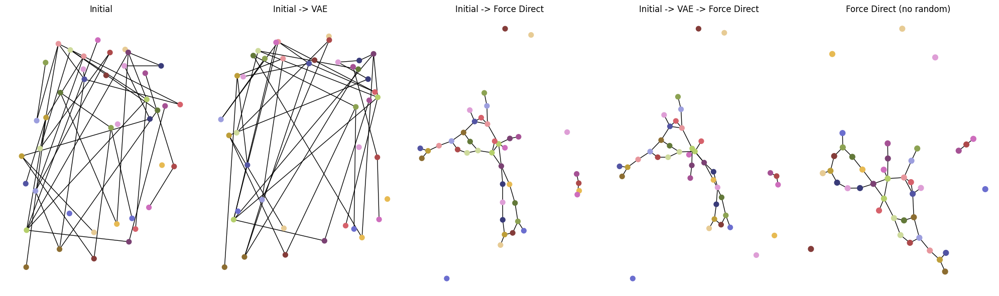

Initial->Force: (0.000954332058589389, 1)
Model (0.0011922100724117287, 1)
Force Only (0.0007539850005935788, 0)
tensor(0.9810, grad_fn=<AddBackward0>)


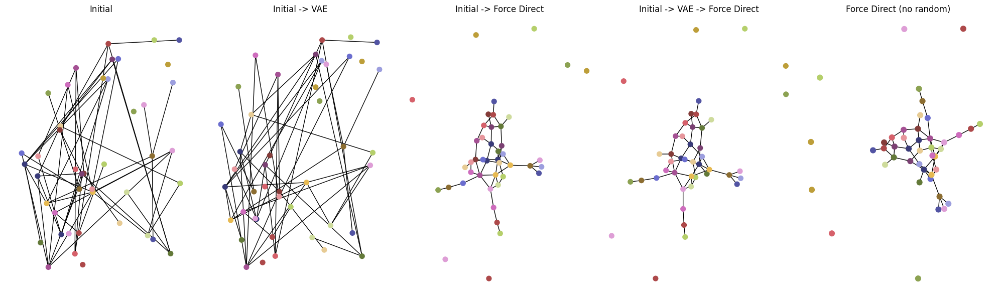

Initial->Force: (0.0008626420379325503, 5)
Model (0.000925417770842947, 4)
Force Only (0.0009173984506788454, 3)
tensor(0.7484, grad_fn=<AddBackward0>)


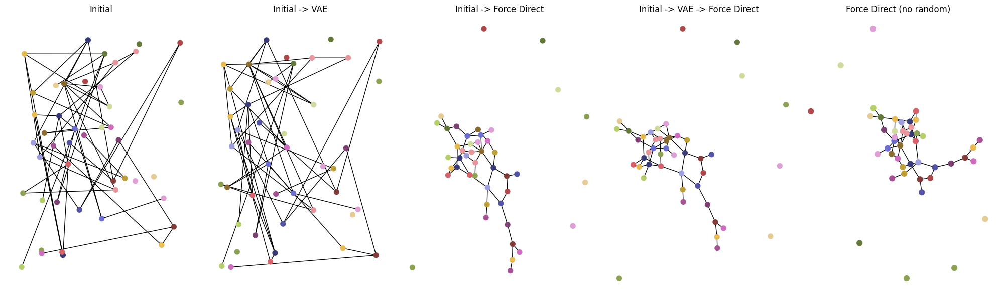

Initial->Force: (0.0011402204597006707, 1)
Model (0.001031421466095155, 2)
Force Only (0.0011467322871528565, 5)
tensor(0.7156, grad_fn=<AddBackward0>)


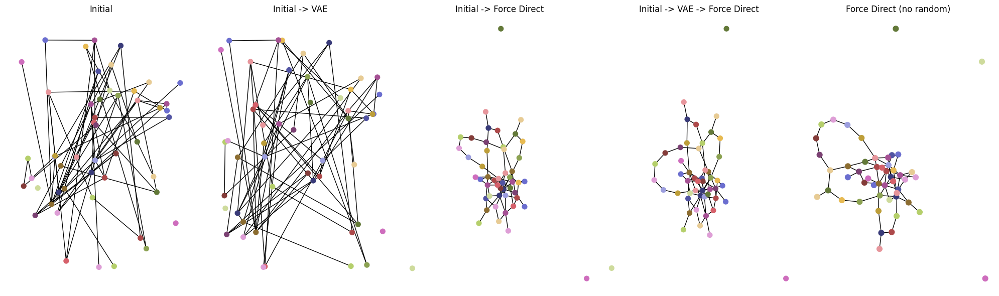

Initial->Force: (0.001087836453269366, 14)
Model (0.0011798061387932497, 11)
Force Only (0.0012427960657574431, 10)
tensor(0.8687, grad_fn=<AddBackward0>)


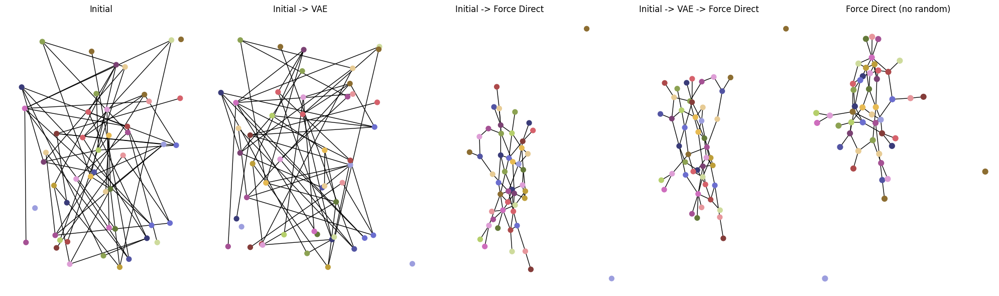

Initial->Force: (0.0013531147482618384, 9)
Model (0.0015634623690617452, 5)
Force Only (0.0015429418370001187, 8)
tensor(0.8908, grad_fn=<AddBackward0>)


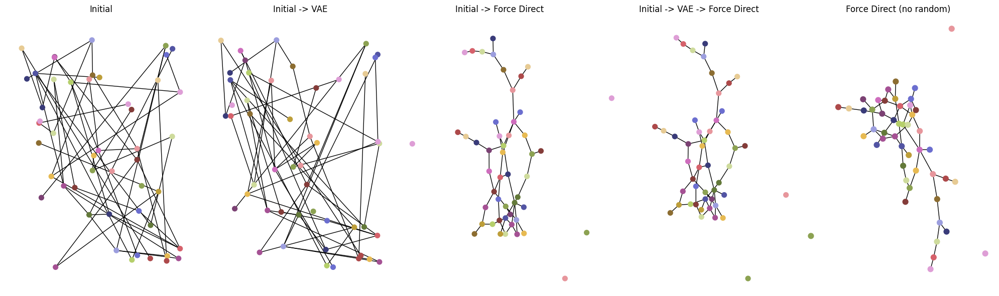

Initial->Force: (0.0008916847547075734, 2)
Model (0.0010673410254433736, 2)
Force Only (0.0016046227791417444, 3)
tensor(0.5728, grad_fn=<AddBackward0>)


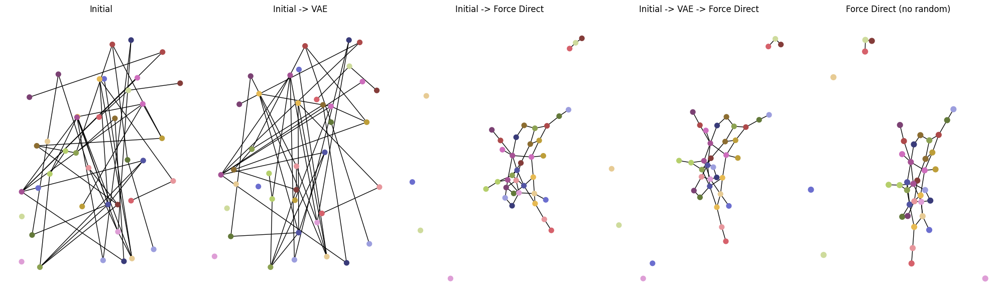

Initial->Force: (0.0009015843879462921, 1)
Model (0.0009347282977669717, 1)
Force Only (0.0008231161167988802, 2)
tensor(0.7089, grad_fn=<AddBackward0>)


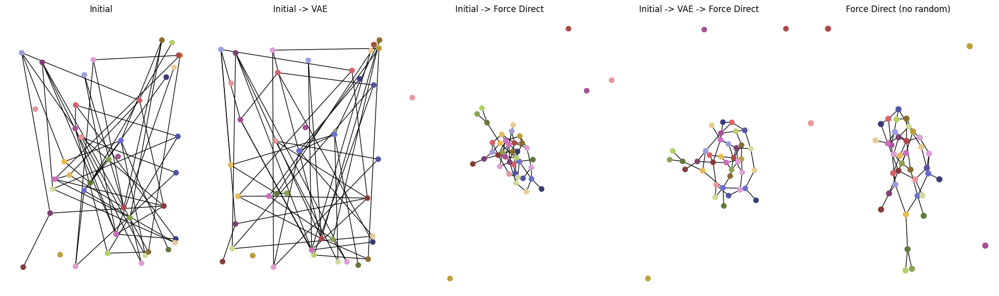

Initial->Force: (0.0012231857059749579, 9)
Model (0.0016982305216756307, 4)
Force Only (0.0014160152375883954, 5)
tensor(0.7472, grad_fn=<AddBackward0>)


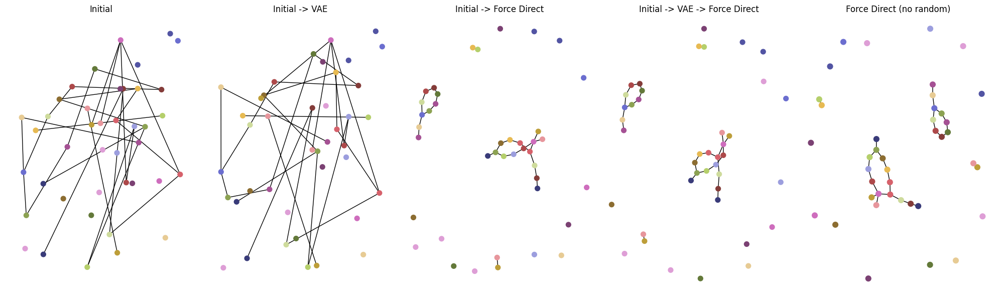

Initial->Force: (0.00027541838326117414, 0)
Model (0.00033280893404086855, 0)
Force Only (0.0003263918308194126, 0)
tensor(0.7265, grad_fn=<AddBackward0>)


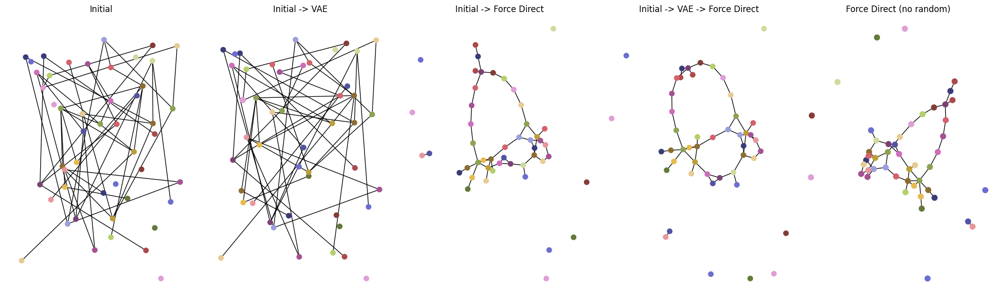

Initial->Force: (0.0009288018740114999, 1)
Model (0.0011085125387369618, 2)
Force Only (0.0008990570671369694, 3)
tensor(0.5800, grad_fn=<AddBackward0>)


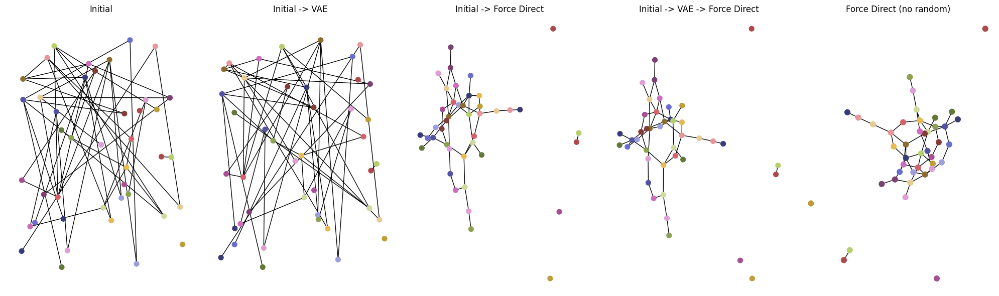

Initial->Force: (0.0008793044486055144, 5)
Model (0.0012577216759820362, 4)
Force Only (0.0007577853504518964, 3)
tensor(0.8041, grad_fn=<AddBackward0>)


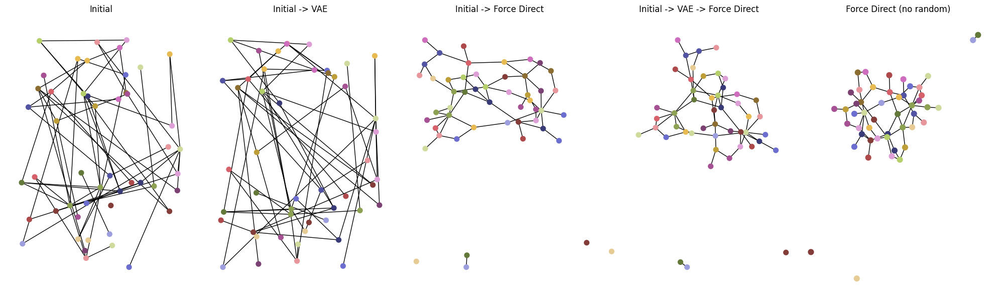

Initial->Force: (0.0011148083560281288, 3)
Model (0.0012917665130640972, 4)
Force Only (0.0012039447498928806, 6)
tensor(0.6339, grad_fn=<AddBackward0>)


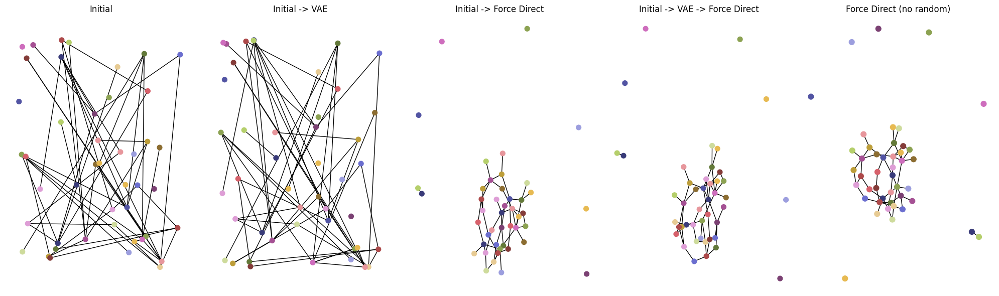

Initial->Force: (0.0011089627875529088, 5)
Model (0.0010653928698068289, 1)
Force Only (0.0008766557425495784, 2)
tensor(0.9370, grad_fn=<AddBackward0>)


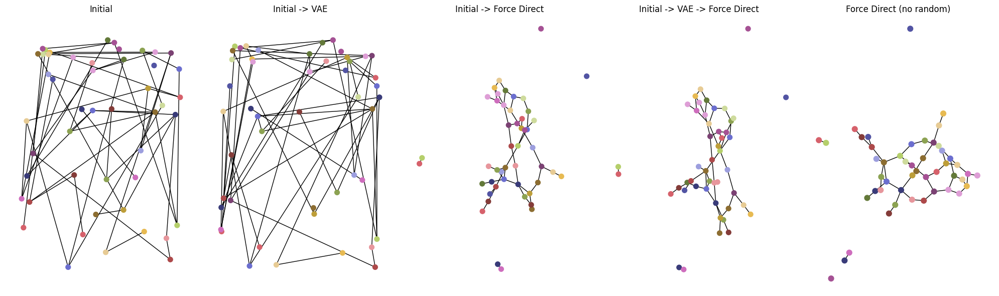

Initial->Force: (0.0013972515519422495, 4)
Model (0.0014172852886815428, 5)
Force Only (0.0009483854247915525, 1)
tensor(0.7263, grad_fn=<AddBackward0>)


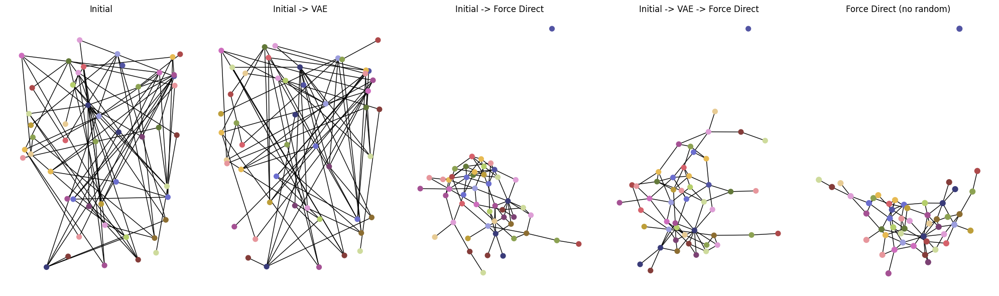

Initial->Force: (0.001266245496632358, 18)
Model (0.0015990305685504673, 10)
Force Only (0.0012958403276971764, 12)
tensor(0.8139, grad_fn=<AddBackward0>)


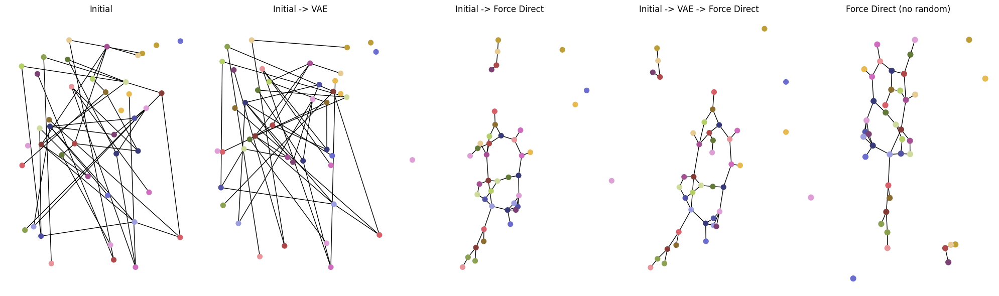

Initial->Force: (0.001000259097116438, 3)
Model (0.0011659106749951375, 2)
Force Only (0.0013637121407749082, 3)
tensor(0.6301, grad_fn=<AddBackward0>)


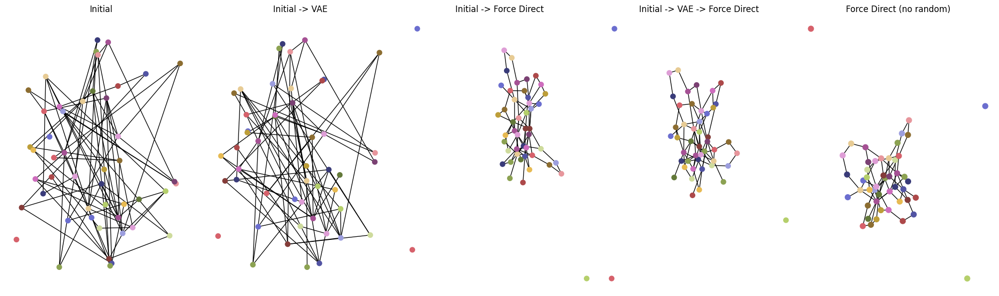

Initial->Force: (0.0014078492231108007, 11)
Model (0.0014357445050582653, 8)
Force Only (0.0011945506799614556, 11)
tensor(0.7251, grad_fn=<AddBackward0>)


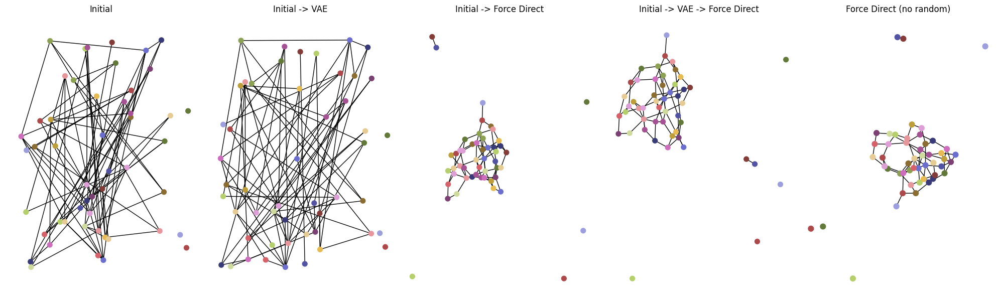

Initial->Force: (0.0010351484754970287, 18)
Model (0.0011962594332556636, 8)
Force Only (0.0014747702758002646, 8)
tensor(0.6513, grad_fn=<AddBackward0>)


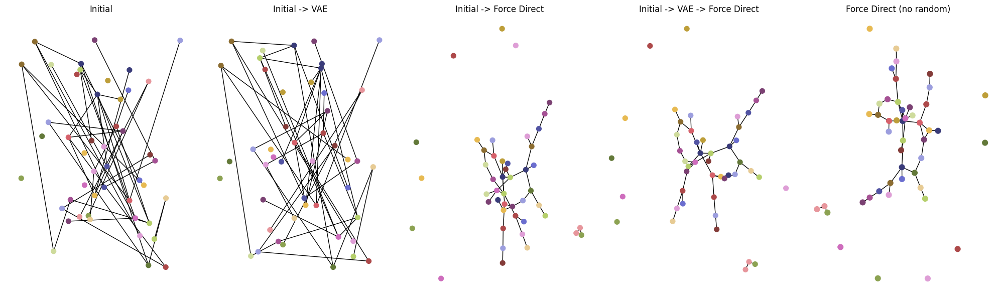

Initial->Force: (0.0011950950872298867, 3)
Model (0.001461718200269135, 4)
Force Only (0.0012483246687793846, 1)
tensor(0.6503, grad_fn=<AddBackward0>)


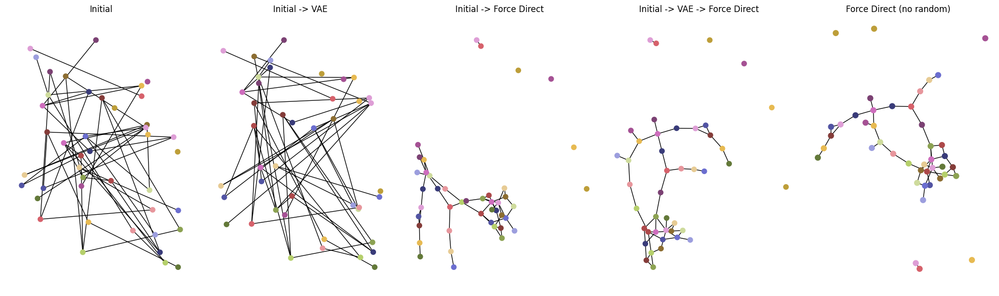

Initial->Force: (0.001071526858977382, 8)
Model (0.0011862277112402798, 2)
Force Only (0.0015644296871425017, 1)
tensor(0.7284, grad_fn=<AddBackward0>)


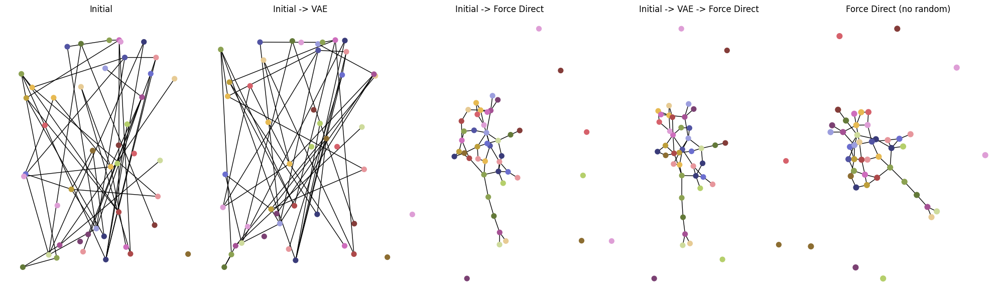

Initial->Force: (0.0010047801214638212, 3)
Model (0.0009487814364389213, 4)
Force Only (0.0006246033253955301, 3)
tensor(0.8144, grad_fn=<AddBackward0>)


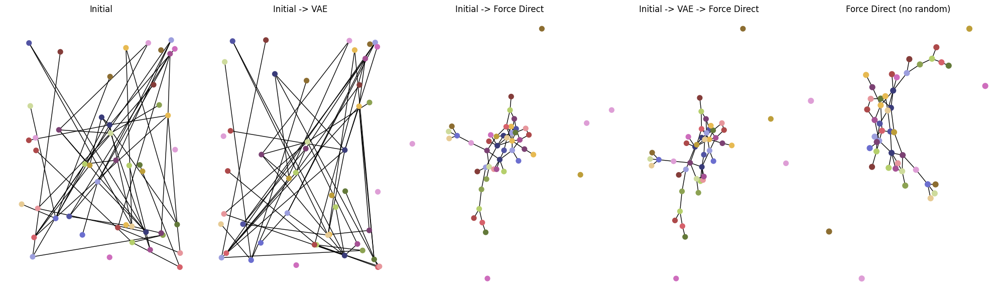

Initial->Force: (0.0011440502947131222, 5)
Model (0.0011166330496506038, 9)
Force Only (0.0012370488068260703, 6)
tensor(0.7383, grad_fn=<AddBackward0>)


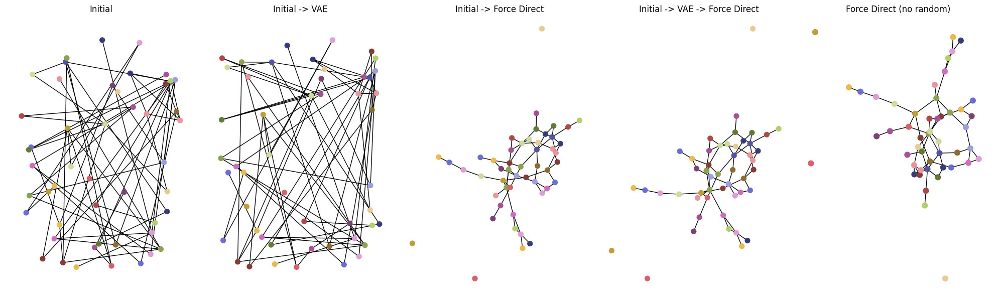

Initial->Force: (0.0013740681669109453, 3)
Model (0.001398815976154743, 4)
Force Only (0.0011979165950554808, 6)
tensor(0.5259, grad_fn=<AddBackward0>)


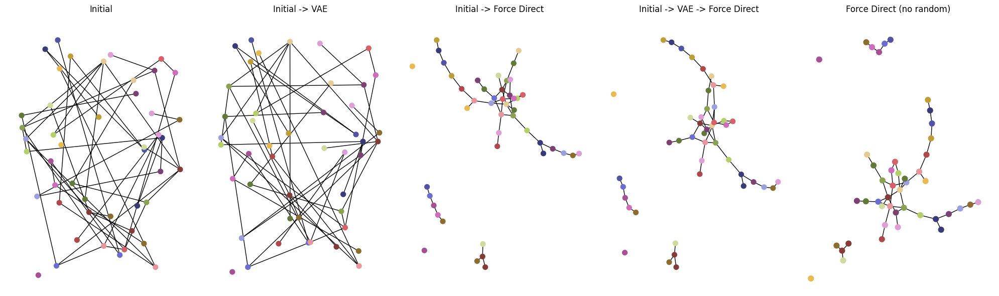

Initial->Force: (0.0010568840624479374, 3)
Model (0.0010415065637867595, 3)
Force Only (0.0010156386363207258, 1)
tensor(0.8237, grad_fn=<AddBackward0>)


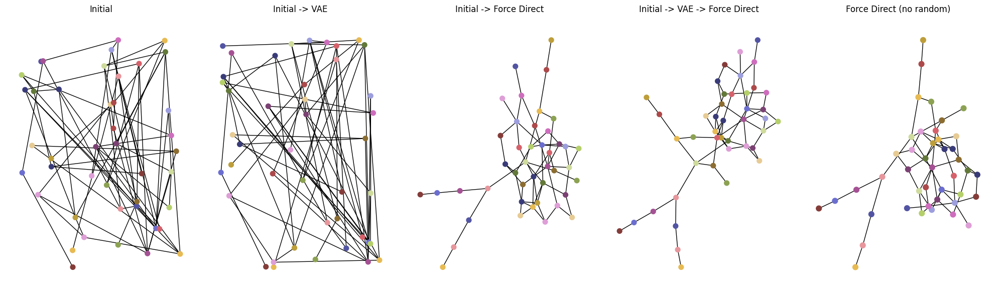

Initial->Force: (0.0032697107816922113, 0)
Model (0.0027050424050458965, 2)
Force Only (0.003239468629936999, 1)
tensor(0.7900, grad_fn=<AddBackward0>)


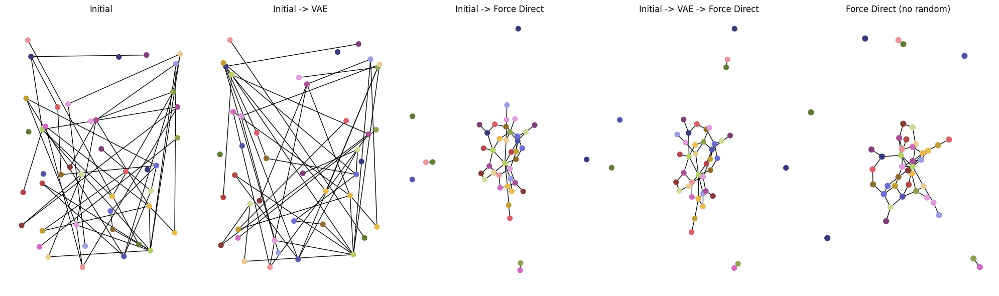

Initial->Force: (0.0008747418925099345, 1)
Model (0.0008580431514445933, 4)
Force Only (0.0010137919528353085, 3)
tensor(1.1181, grad_fn=<AddBackward0>)


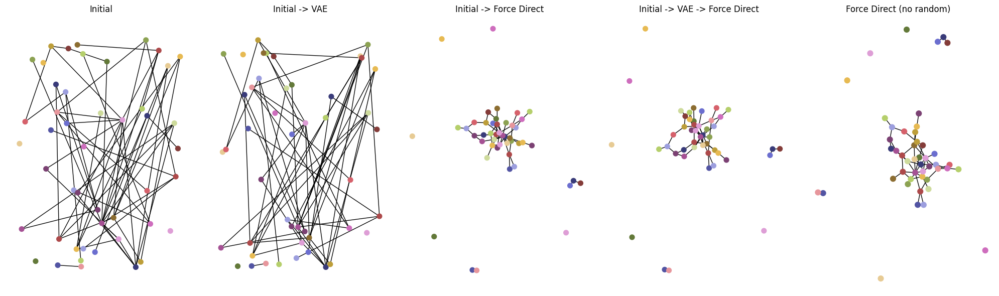

Initial->Force: (0.0010737621227823548, 15)
Model (0.00109040271360375, 9)
Force Only (0.0009299012243384224, 7)
tensor(0.5742, grad_fn=<AddBackward0>)


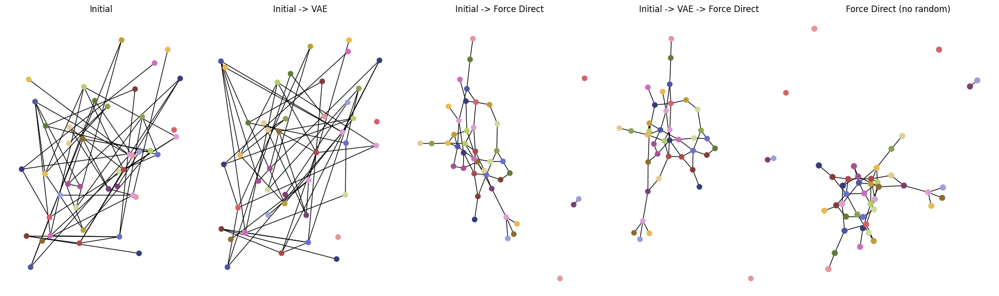

Initial->Force: (0.001064253841634682, 3)
Model (0.0009245859083249555, 3)
Force Only (0.001235236544421287, 11)
tensor(0.9659, grad_fn=<AddBackward0>)


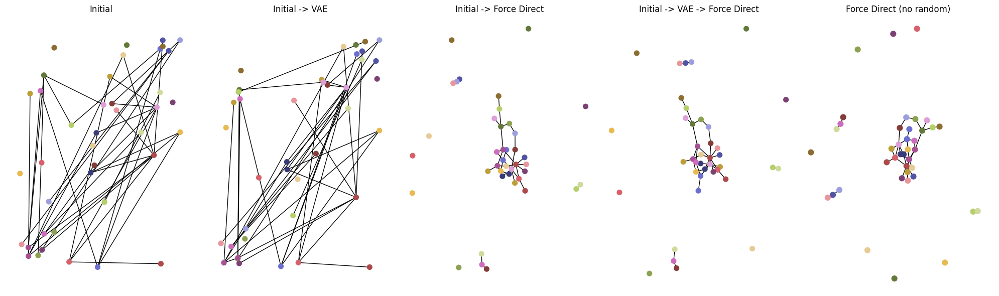

Initial->Force: (0.0011179338703029267, 5)
Model (0.0007831110700573284, 3)
Force Only (0.0007600462762644227, 2)
tensor(0.6025, grad_fn=<AddBackward0>)


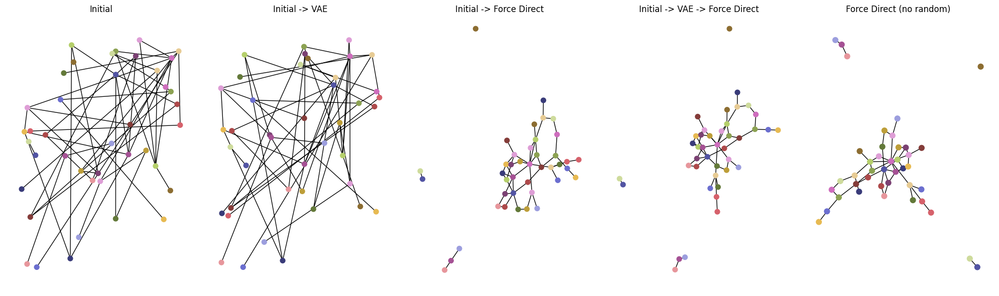

Initial->Force: (0.0012216567069559046, 2)
Model (0.001465790463364647, 1)
Force Only (0.002089564482856843, 0)
tensor(0.5249, grad_fn=<AddBackward0>)


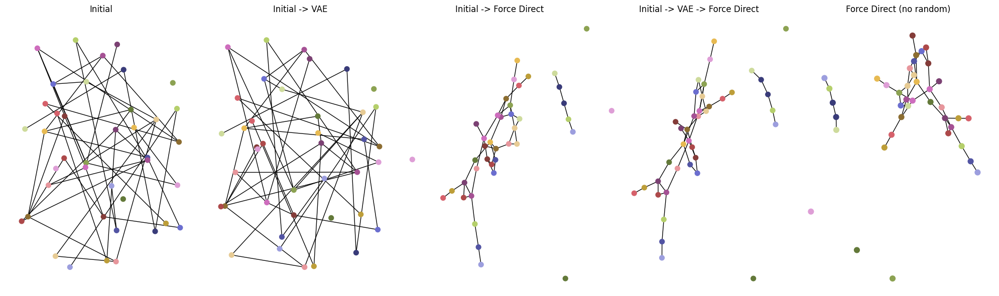

Initial->Force: (0.0013395361334043684, 3)
Model (0.001632803697381147, 3)
Force Only (0.0011741214293717276, 4)
tensor(0.7370, grad_fn=<AddBackward0>)


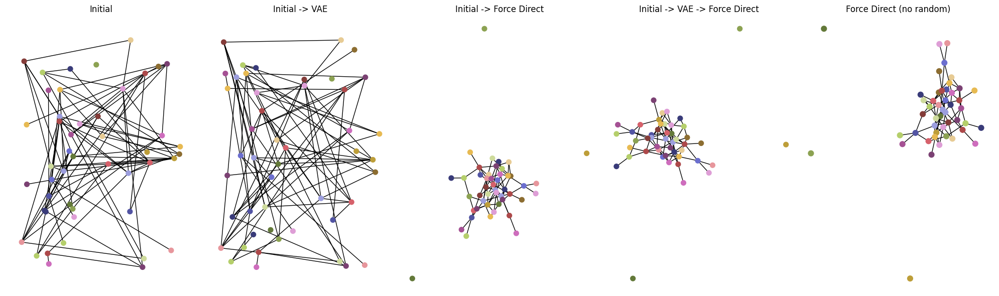

Initial->Force: (0.0012623752432179003, 18)
Model (0.001034755637332918, 15)
Force Only (0.0010654515734819512, 20)
tensor(1.0603, grad_fn=<AddBackward0>)


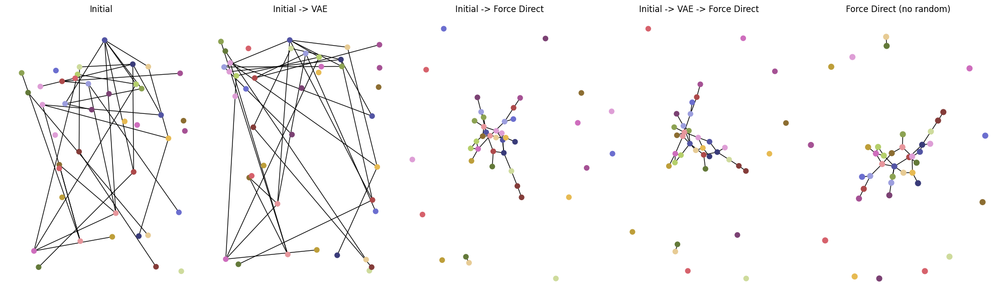

Initial->Force: (0.0011042840994038906, 7)
Model (0.0011404170431732123, 2)
Force Only (0.001024638952016841, 2)
tensor(0.5635, grad_fn=<AddBackward0>)


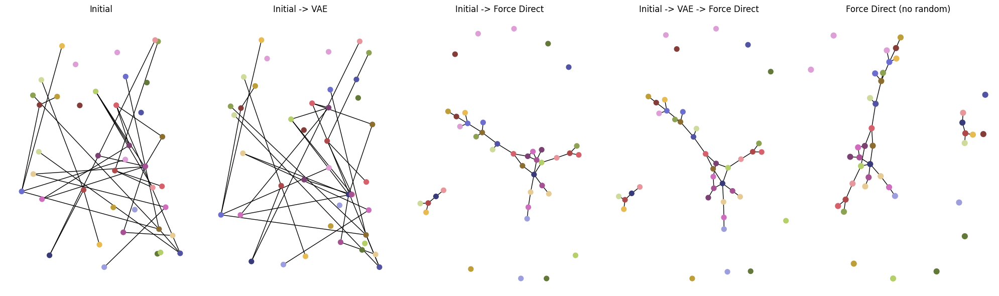

Initial->Force: (0.0011257906203249227, 0)
Model (0.0010899535459691985, 0)
Force Only (0.0012184190950702695, 0)
tensor(0.7559, grad_fn=<AddBackward0>)


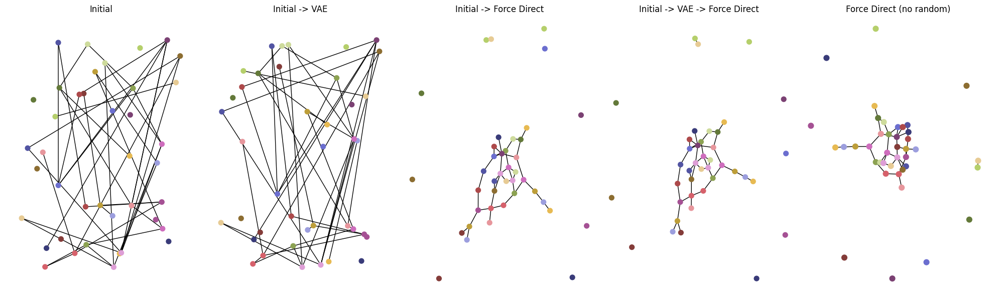

Initial->Force: (0.000862381322628864, 1)
Model (0.0008890701804548157, 1)
Force Only (0.001191898056897287, 3)
tensor(0.7332, grad_fn=<AddBackward0>)


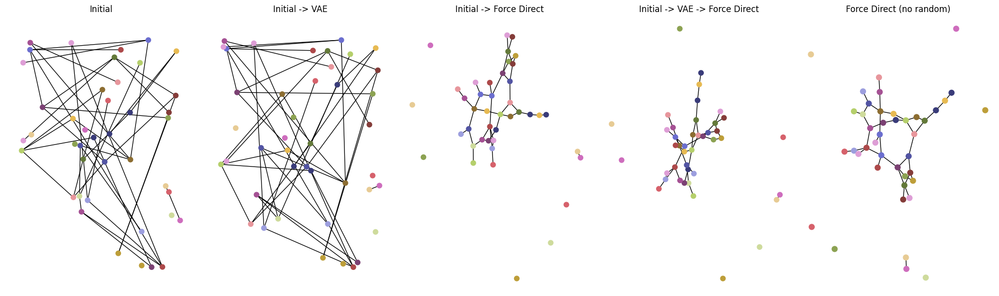

Initial->Force: (0.0008905567800572979, 1)
Model (0.001346649809186827, 5)
Force Only (0.0008901412666262164, 1)
tensor(0.6978, grad_fn=<AddBackward0>)


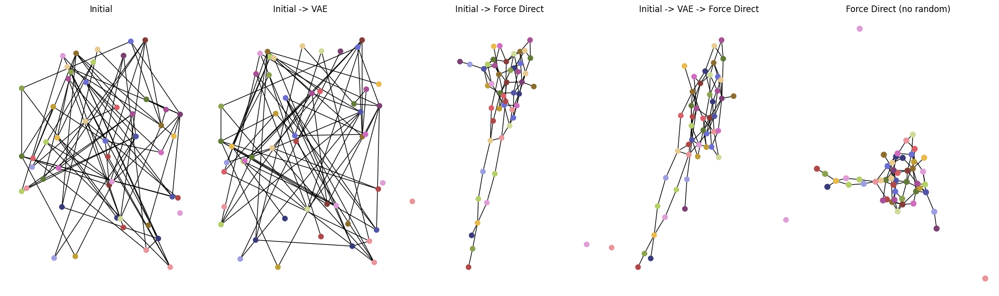

Initial->Force: (0.0012442896419816046, 11)
Model (0.0011179551669082456, 10)
Force Only (0.0011724854506234411, 15)
tensor(0.6367, grad_fn=<AddBackward0>)


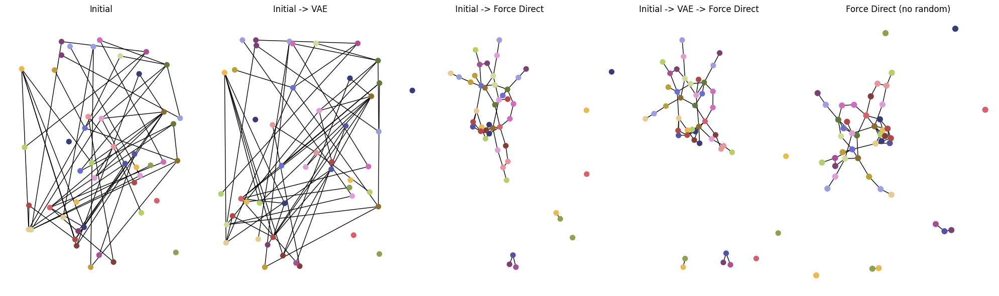

Initial->Force: (0.0014207827246791763, 6)
Model (0.0014087188282332142, 4)
Force Only (0.0016251350411818496, 8)
tensor(0.7739, grad_fn=<AddBackward0>)


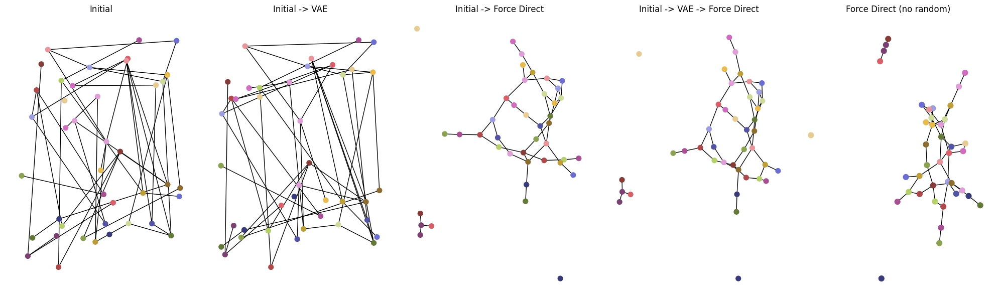

Initial->Force: (0.0014484126093239754, 2)
Model (0.001463263612672605, 0)
Force Only (0.0018179134411041083, 5)
tensor(0.8901, grad_fn=<AddBackward0>)


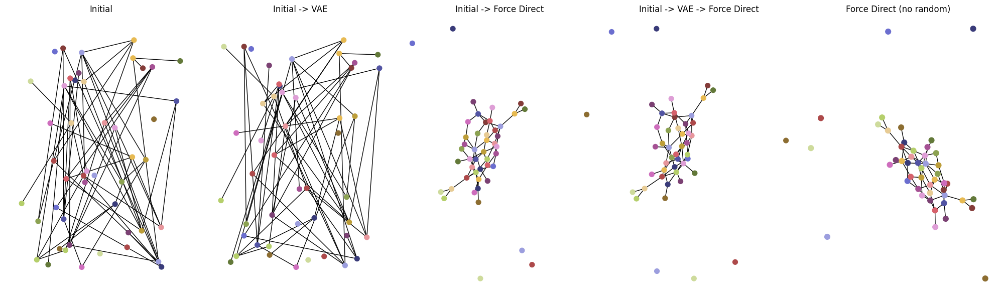

Initial->Force: (0.0007010424468943615, 7)
Model (0.0008375387639637421, 6)
Force Only (0.000630952865537265, 10)
tensor(0.6983, grad_fn=<AddBackward0>)


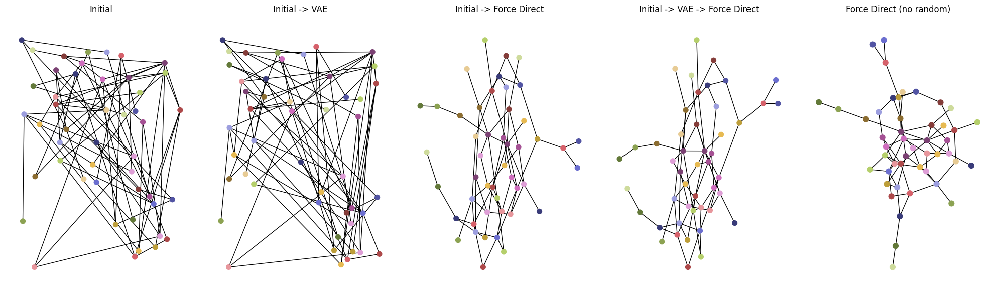

Initial->Force: (0.004048677703306678, 1)
Model (0.003604371225172295, 0)
Force Only (0.0032423428228673342, 1)
tensor(0.5069, grad_fn=<AddBackward0>)


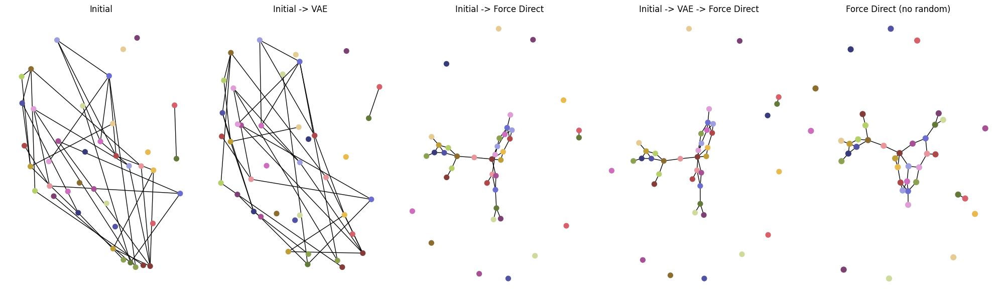

Initial->Force: (0.0010364140531039896, 2)
Model (0.000957276761438758, 2)
Force Only (0.0009874449814779123, 0)
tensor(0.6738, grad_fn=<AddBackward0>)


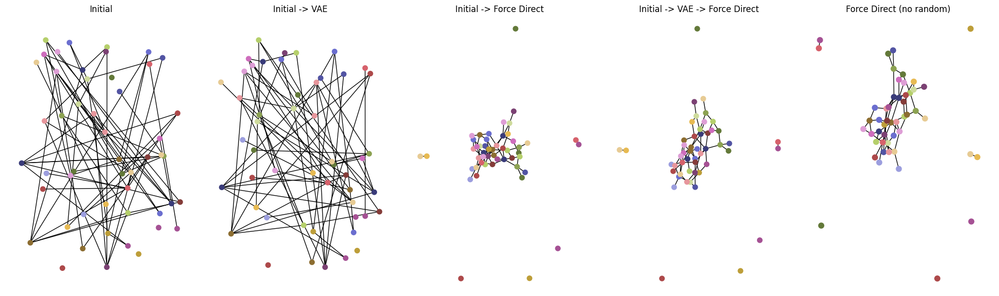

Initial->Force: (0.0008361301957720584, 10)
Model (0.0011222341430636512, 9)
Force Only (0.001069931142729264, 6)
tensor(0.6956, grad_fn=<AddBackward0>)


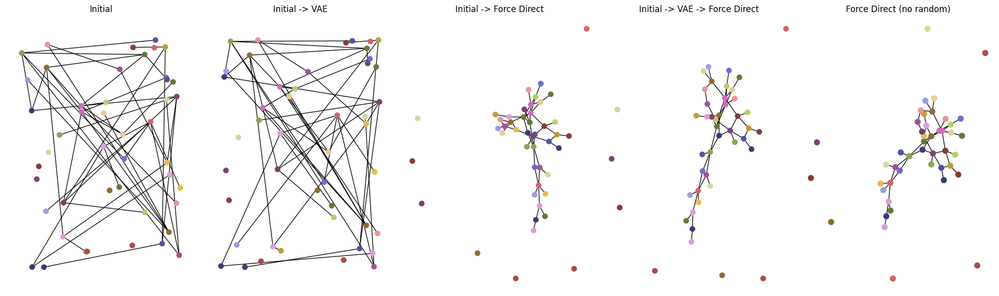

Initial->Force: (0.0009566269338877038, 3)
Model (0.0008944795890641767, 6)
Force Only (0.000732377468480358, 5)
tensor(0.9211, grad_fn=<AddBackward0>)


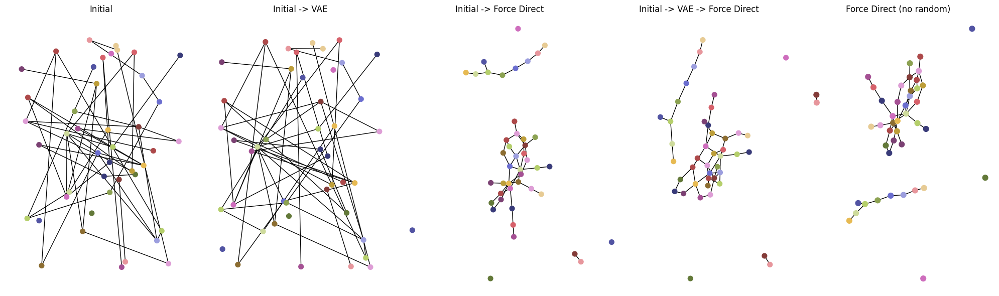

Initial->Force: (0.000561604518752639, 4)
Model (0.0010972545938808908, 2)
Force Only (0.0007844788258058766, 2)
tensor(0.7137, grad_fn=<AddBackward0>)


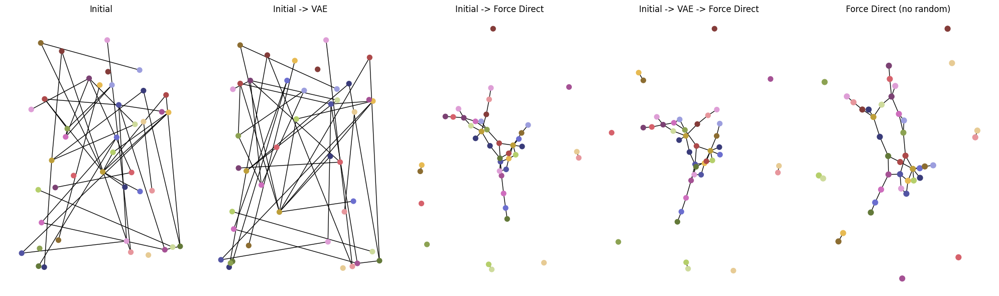

Initial->Force: (0.001036704327440944, 3)
Model (0.0009021989279411814, 3)
Force Only (0.0010837484753642448, 0)
tensor(0.7179, grad_fn=<AddBackward0>)


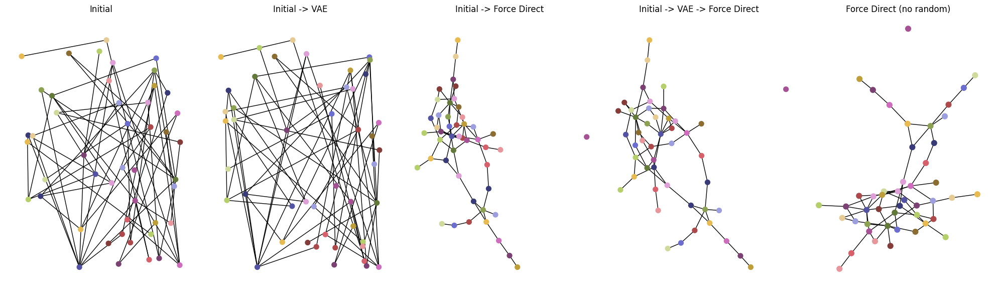

Initial->Force: (0.000938484790614005, 6)
Model (0.0013086540641521556, 2)
Force Only (0.0012236071232978262, 8)
tensor(0.5400, grad_fn=<AddBackward0>)


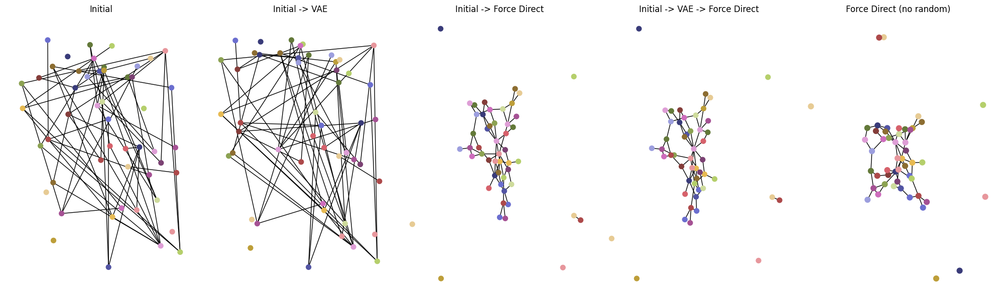

Initial->Force: (0.0012409636431353504, 2)
Model (0.0011354453437372647, 5)
Force Only (0.00131919826248286, 7)
tensor(0.7764, grad_fn=<AddBackward0>)


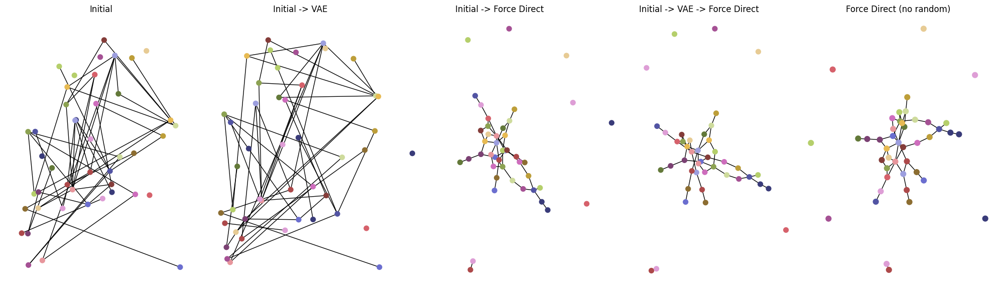

Initial->Force: (0.000807376268641315, 5)
Model (0.0012447611037439763, 1)
Force Only (0.000831429350942359, 2)
tensor(0.5997, grad_fn=<AddBackward0>)


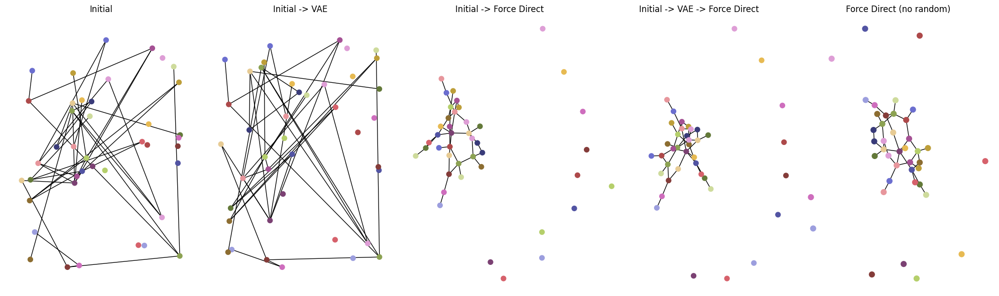

Initial->Force: (0.0011177531102239257, 2)
Model (0.0009521966046698412, 5)
Force Only (0.0010596348386944588, 1)
tensor(0.6278, grad_fn=<AddBackward0>)


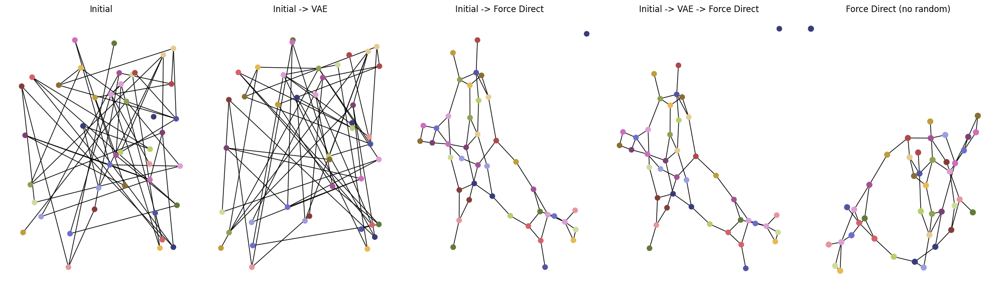

Initial->Force: (0.0015144475395183568, 0)
Model (0.001832556632987925, 0)
Force Only (0.002037526584902764, 1)
tensor(0.5799, grad_fn=<AddBackward0>)


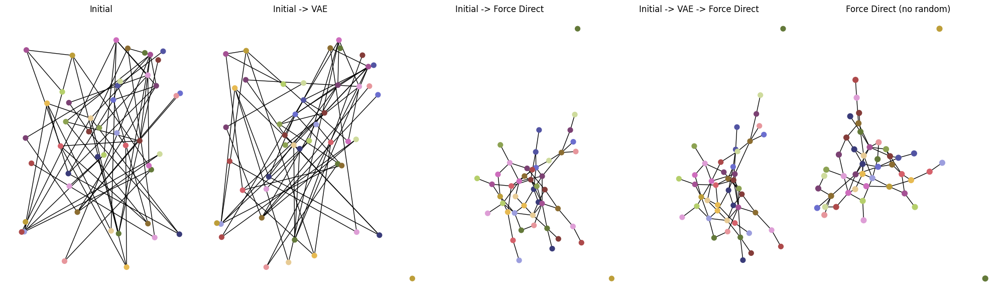

Initial->Force: (0.0010226991847370028, 5)
Model (0.0012764145693648454, 8)
Force Only (0.0016862081674088034, 1)
tensor(0.7499, grad_fn=<AddBackward0>)


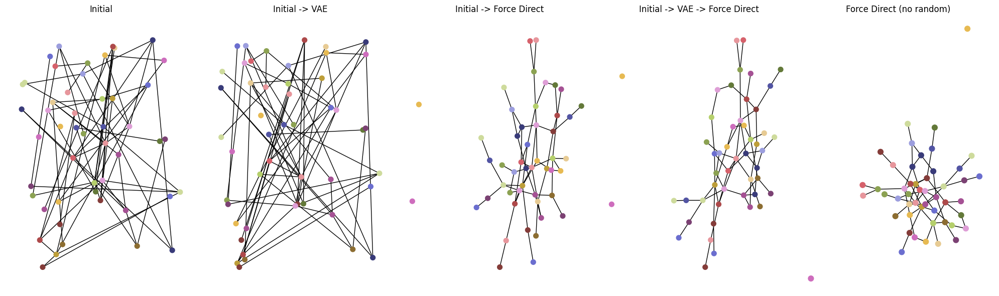

Initial->Force: (0.0009481516303743722, 5)
Model (0.000843417052663842, 4)
Force Only (0.0012276598393403798, 6)
tensor(0.5496, grad_fn=<AddBackward0>)


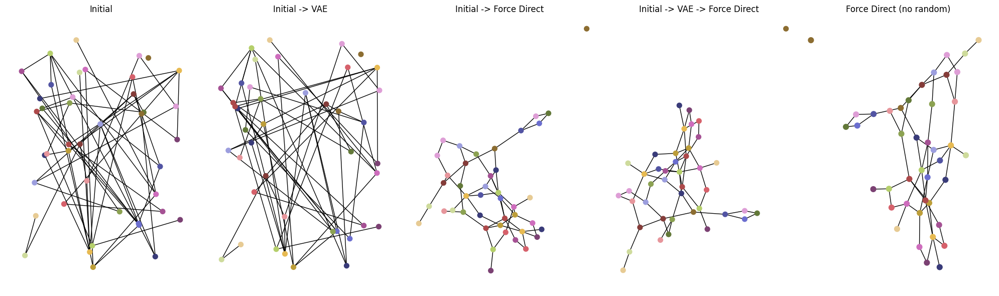

Initial->Force: (0.00116985460926876, 2)
Model (0.0016059595930686178, 1)
Force Only (0.0014110898242601724, 1)
tensor(0.6254, grad_fn=<AddBackward0>)


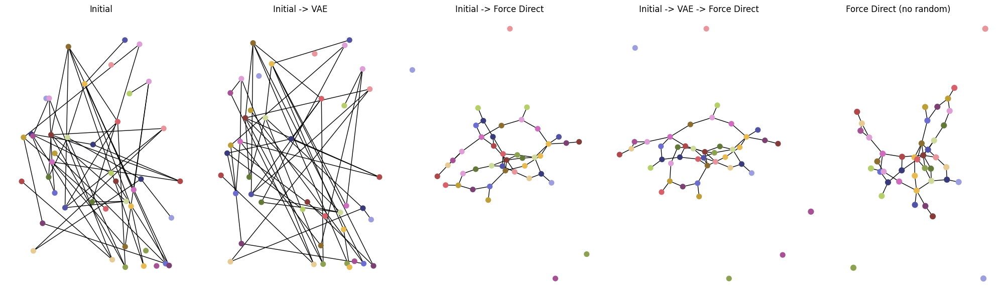

Initial->Force: (0.0010302063380455417, 3)
Model (0.0009933540343196163, 2)
Force Only (0.0010674885218446978, 2)
tensor(0.5476, grad_fn=<AddBackward0>)


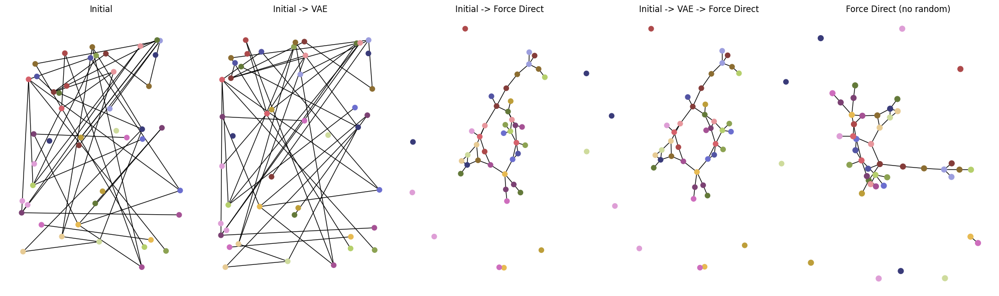

Initial->Force: (0.0011702880764231987, 0)
Model (0.0011230190957929658, 0)
Force Only (0.0014134112347778576, 4)
tensor(0.7777, grad_fn=<AddBackward0>)


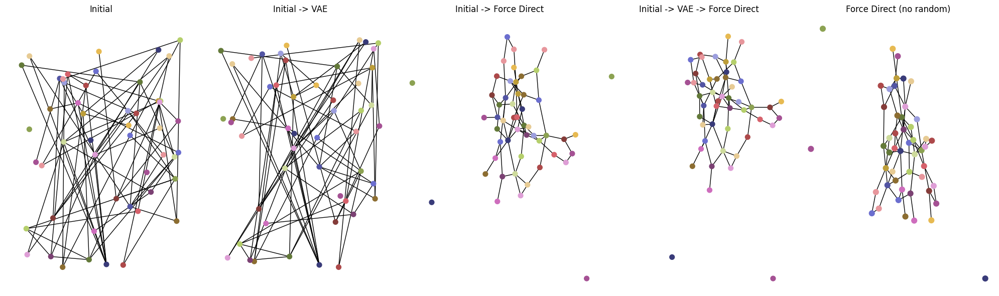

Initial->Force: (0.0011366920319333782, 4)
Model (0.0012039671907965322, 8)
Force Only (0.0011946577858190676, 7)
tensor(0.5465, grad_fn=<AddBackward0>)


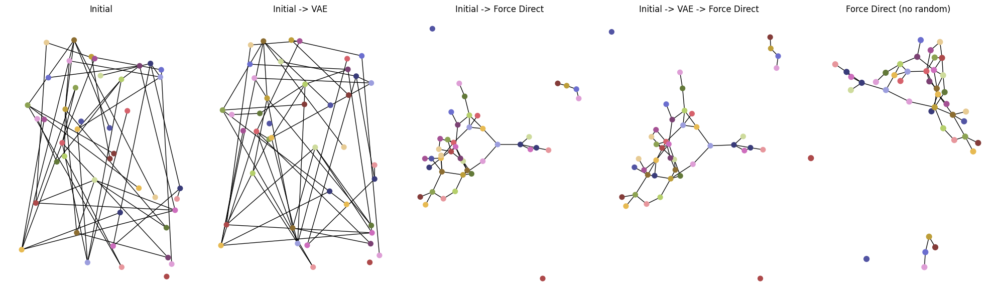

Initial->Force: (0.0013539473069940292, 5)
Model (0.0017850299013178086, 3)
Force Only (0.0014998701702251614, 2)
tensor(0.6639, grad_fn=<AddBackward0>)


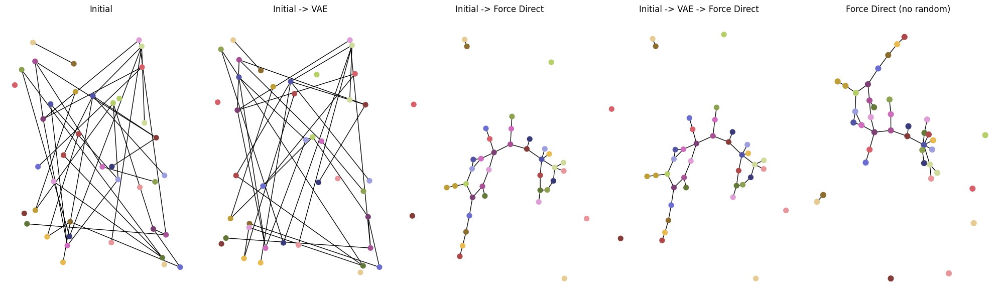

Initial->Force: (0.0009627694085142837, 0)
Model (0.0010145090415240334, 0)
Force Only (0.0012017351115037047, 2)
tensor(0.6005, grad_fn=<AddBackward0>)


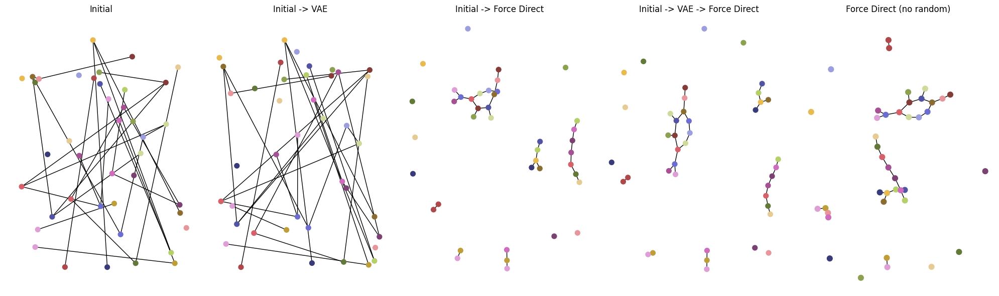

Initial->Force: (0.00034442483276550653, 1)
Model (0.00027701155732993635, 0)
Force Only (0.0003551162235720099, 3)
tensor(0.6959, grad_fn=<AddBackward0>)


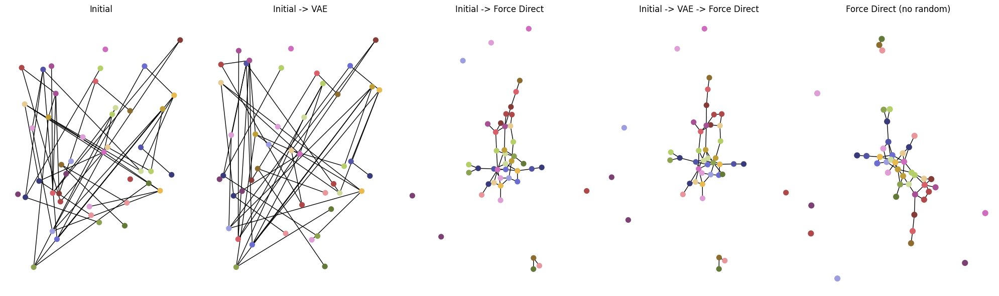

Initial->Force: (0.0008734434047332351, 4)
Model (0.0009058838204228926, 6)
Force Only (0.0009787328021469922, 3)
tensor(0.6900, grad_fn=<AddBackward0>)


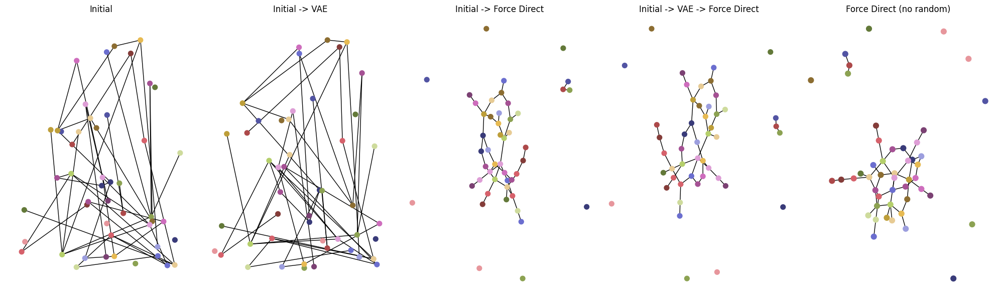

Initial->Force: (0.0009411149082352591, 3)
Model (0.0010885473842149028, 0)
Force Only (0.0009578183943953534, 2)
tensor(0.7301, grad_fn=<AddBackward0>)


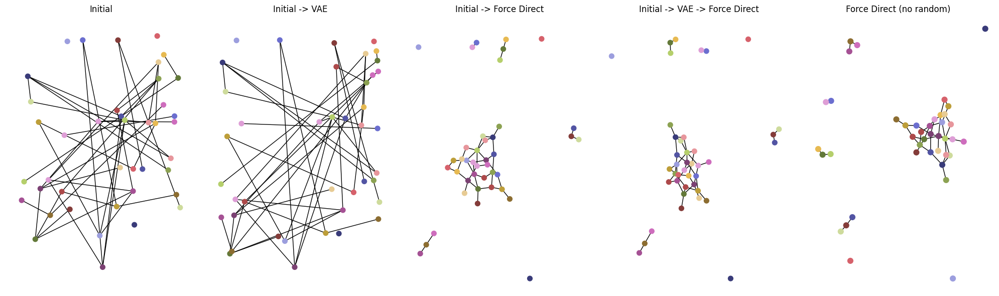

Initial->Force: (0.0004861735798145625, 4)
Model (0.0008530352361270264, 2)
Force Only (0.0008718591762571429, 2)
tensor(0.7714, grad_fn=<AddBackward0>)


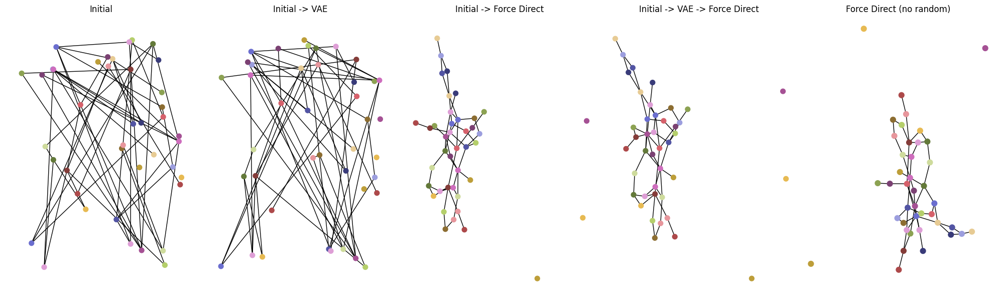

Initial->Force: (0.0012187012407712202, 4)
Model (0.0011987485042307855, 4)
Force Only (0.0012247575280297026, 3)
tensor(0.8217, grad_fn=<AddBackward0>)


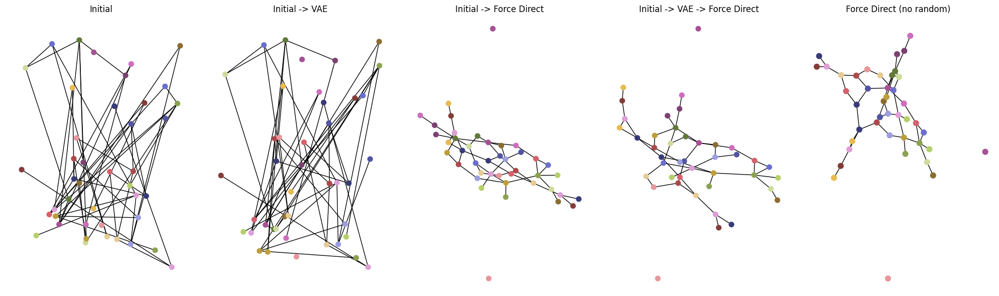

Initial->Force: (0.0007832044321153103, 7)
Model (0.0009781064453224869, 4)
Force Only (0.0011766606627081218, 3)
tensor(0.8642, grad_fn=<AddBackward0>)


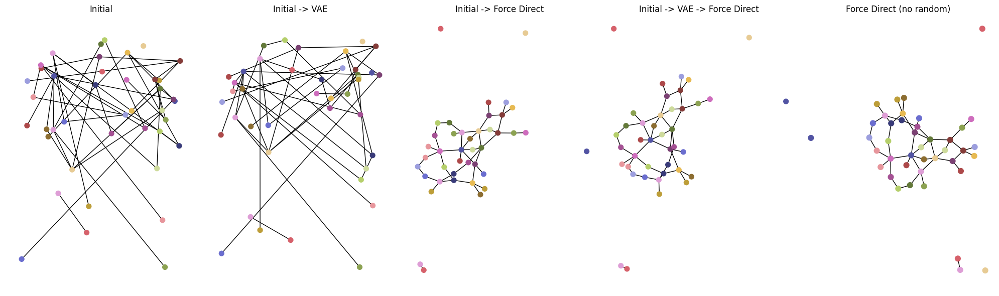

Initial->Force: (0.0008053464891989108, 1)
Model (0.000856705449791947, 1)
Force Only (0.0007155241586061044, 2)
tensor(0.6826, grad_fn=<AddBackward0>)


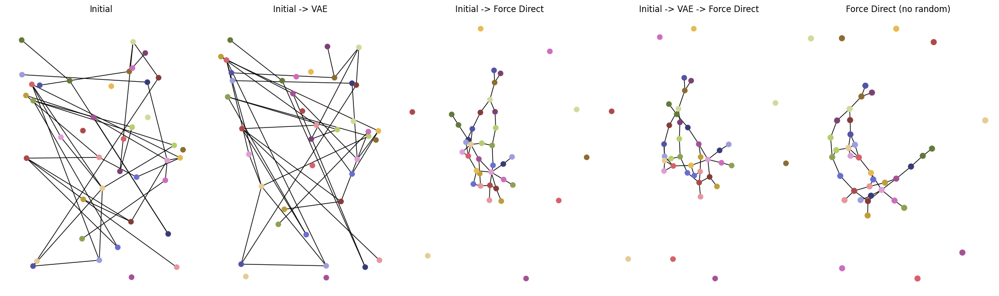

Initial->Force: (0.000799549799756399, 3)
Model (0.0010567085053608057, 2)
Force Only (0.0010875085258954212, 1)
tensor(0.5948, grad_fn=<AddBackward0>)


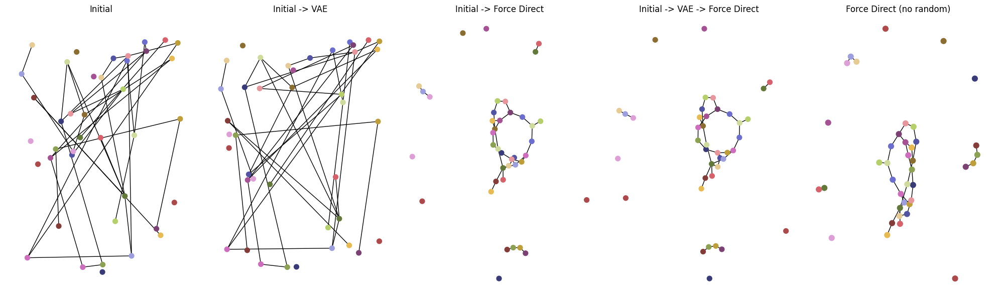

Initial->Force: (0.0009335933563320972, 3)
Model (0.0008271229227976806, 3)
Force Only (0.0012232717599788263, 1)
tensor(0.6969, grad_fn=<AddBackward0>)


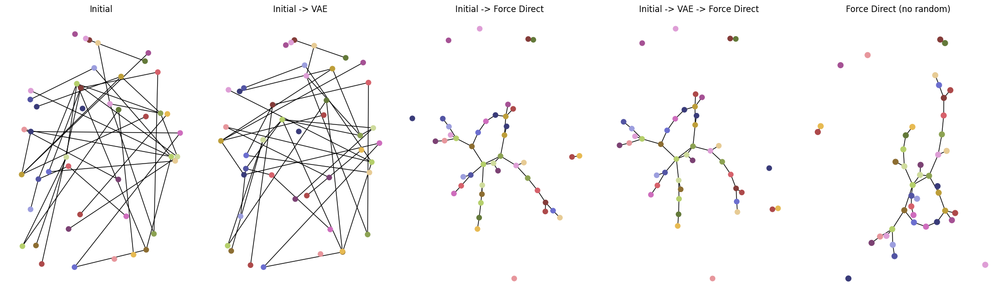

Initial->Force: (0.0013507195606560687, 0)
Model (0.0013615766849990629, 0)
Force Only (0.0015646255602030671, 0)
tensor(0.8315, grad_fn=<AddBackward0>)


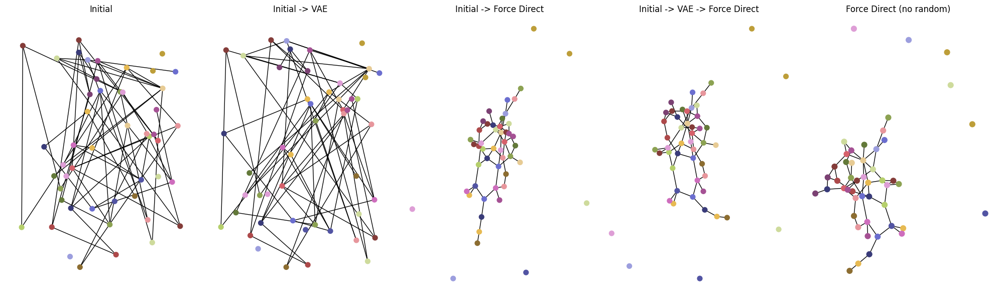

Initial->Force: (0.001123531953019514, 8)
Model (0.0012724067328510845, 5)
Force Only (0.001078883389936664, 4)
tensor(0.8811, grad_fn=<AddBackward0>)


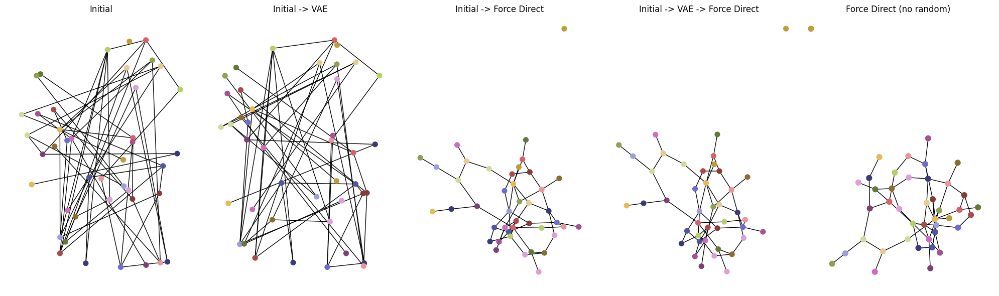

Initial->Force: (0.001174219911040805, 10)
Model (0.0014150748861183617, 6)
Force Only (0.00169899391661484, 2)
tensor(0.9096, grad_fn=<AddBackward0>)


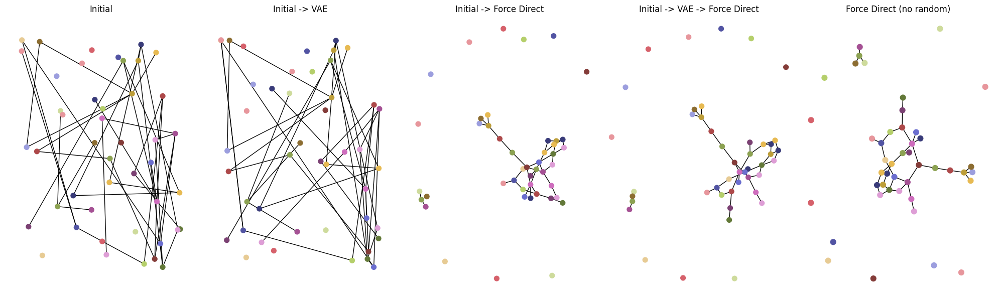

Initial->Force: (0.0009432426050635178, 4)
Model (0.0012934256028055348, 6)
Force Only (0.0011791367399545025, 1)
tensor(0.8407, grad_fn=<AddBackward0>)


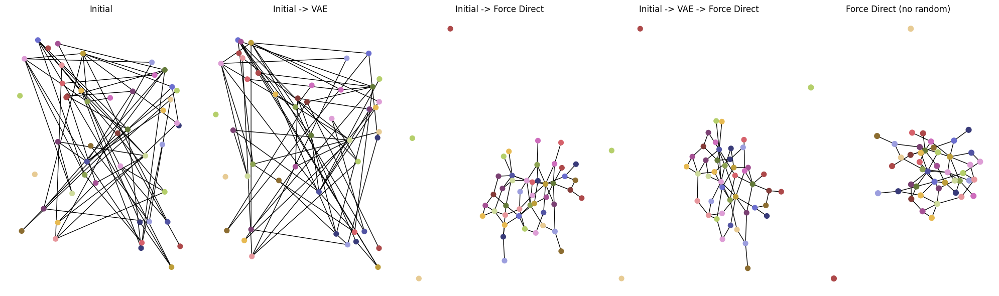

Initial->Force: (0.0007471512638789119, 8)
Model (0.0008129256994285888, 8)
Force Only (0.0009185302904679375, 10)
tensor(0.6889, grad_fn=<AddBackward0>)


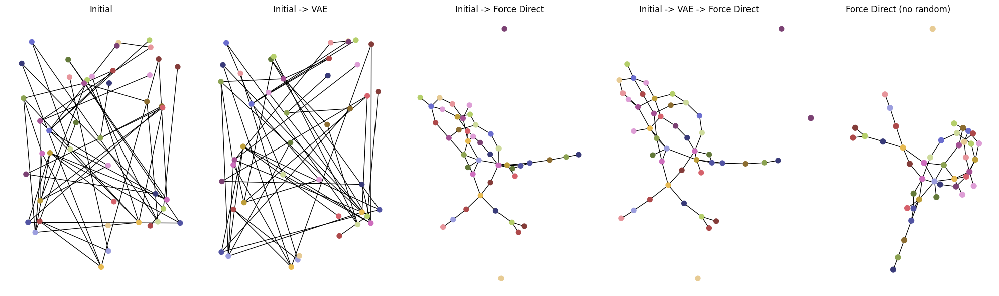

Initial->Force: (0.001213408567484913, 2)
Model (0.001169194362348042, 0)
Force Only (0.0010830686279535613, 2)
tensor(0.6867, grad_fn=<AddBackward0>)


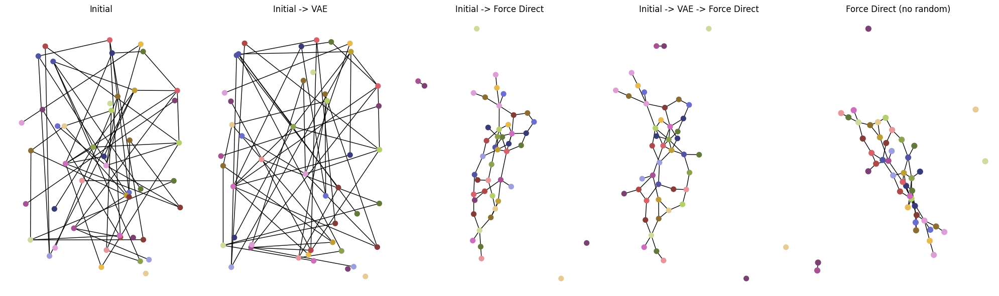

Initial->Force: (0.0013084542803797907, 4)
Model (0.0011683992043219197, 0)
Force Only (0.0010500274512456904, 4)
tensor(0.5354, grad_fn=<AddBackward0>)


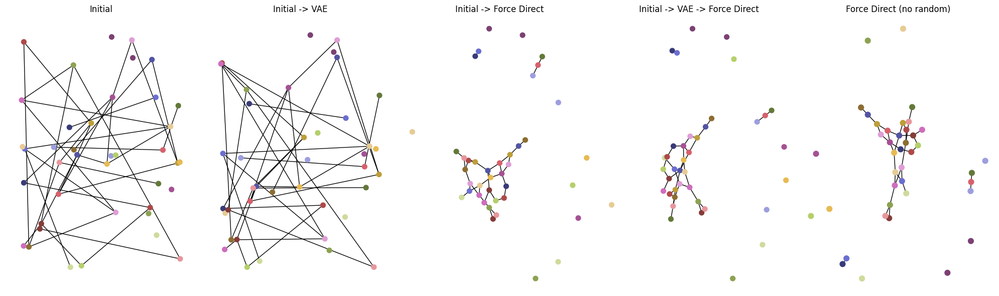

Initial->Force: (0.000812486356082643, 1)
Model (0.0008177962975189826, 2)
Force Only (0.001012082491106798, 1)
tensor(0.7133, grad_fn=<AddBackward0>)


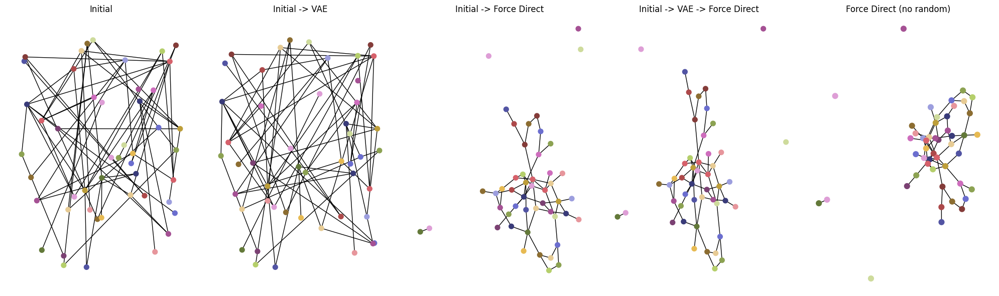

Initial->Force: (0.0012157421418435394, 2)
Model (0.0012235124808510865, 2)
Force Only (0.0013400006833790773, 8)
tensor(0.3994, grad_fn=<AddBackward0>)


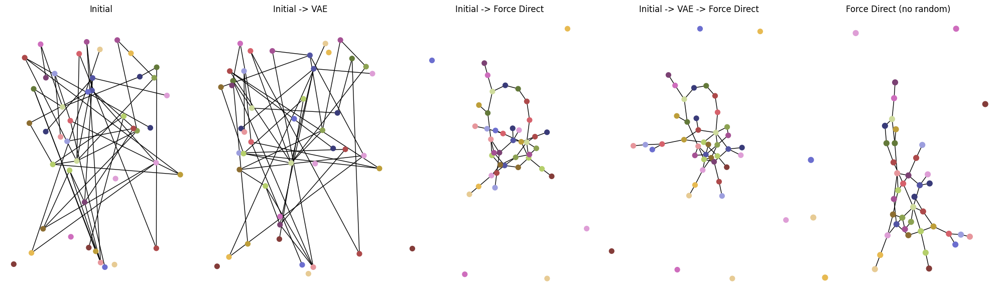

Initial->Force: (0.0007627383512963017, 5)
Model (0.0011475643225519053, 3)
Force Only (0.0007913293065292928, 0)
tensor(0.8492, grad_fn=<AddBackward0>)


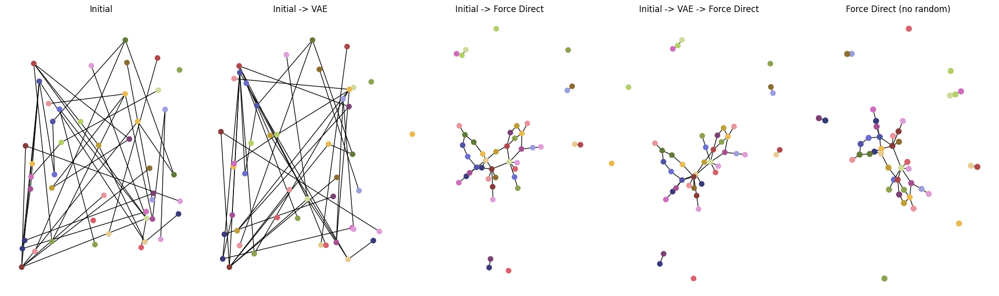

Initial->Force: (0.0011509855209234465, 1)
Model (0.0012243971642024868, 2)
Force Only (0.0009804339744568706, 3)


In [14]:
scores_model = []
scores_force = []
scores_force_only = []
hidden_dim = 1024
latent_dim = 30
num_instances = 100
for i in range (num_instances):
    num_nodes = random.randint (40, 50)
    p = 0.05#random.uniform (0.05, 0.06)
    G = nx.fast_gnp_random_graph (n = num_nodes, p=p)
    initial_pos = torch.tensor (np.random.rand(num_nodes, 2), dtype = torch.float )
    
    edges = list(G.edges)
    data = initial_pos.view(1, -1)  # Flatten and add batch dimension
    
    input_dim = num_nodes * 2
    
    model = VAE (hidden_dims = hidden_dim, input_dim = input_dim, latent_dim = latent_dim)
    optimizer = optim.Adam (model.parameters(), lr = 1e-3, weight_decay = 1e-5)
    
    train (model, optimizer, data)
    
    with torch.no_grad():
        recon, _, _ = model(data)
        recon_pos = recon.numpy().reshape(num_nodes, 2)
        recon_pos_dict = {i: recon_pos[i] for i in range(num_nodes)}
        
        #print (recon_pos[:5])
    
    #Initial Layout
        initial_pos = initial_pos.numpy().reshape (num_nodes, 2)
        initial_ = {i: initial_pos[i] for i in range (num_nodes)}
        #plot_graph (G, initial_, 'Initial')
    
    #VAE reconstructed
        #plot_graph(G, recon_pos_dict, "Initial -> VAE")
    
    #Initial Layout with Force Direct Optimization
        #initial_ = {i: initial_pos[i] for i in range (num_nodes)}
#        print (initial_)
        initial_force = optimize_layout (G, initial_)
        initial_force = {i: initial_force[i] for i in range (num_nodes)}
        #plot_graph (G, initial_force, 'Initial -> Force Direct')
    
    #Initial Layout -> VAE -> Force Direct Optimization
        recon_force = optimize_layout (G, recon_pos_dict)
        recon_force = {i: recon_force[i] for i in range (num_nodes)}
        #plot_graph (G, recon_force, 'Initial -> VAE -> Force Direct')
    
    #Force (No Random initialization)
        #nx.draw(G, pos = nx.kamada_kawai_layout(G), with_labels=True, node_color='skyblue', edge_color='k', node_size = 100)
        
#        plt.figure (figsize)
                    
        force_only_pos = nx.spring_layout (G, iterations = 50)
    # Calculate metrics
        tensor_initial_force = torch.tensor(np.array(list(initial_force.values())))
        tensor_output_force = torch.tensor (np.array (list(recon_force.values())))
        tensor_force_only = torch.tensor (np.array(list(force_only_pos.values())))
        
        edge_var_initial_force, overlap_count_initial_force = calculate_aesthetic_metrics (tensor_initial_force, edges)
        edge_var_output_force, overlap_count_output_force = calculate_aesthetic_metrics(tensor_output_force, edges)
        edge_var_force_only, overlap_count_force_only = calculate_aesthetic_metrics (tensor_force_only, edges)
        
        #print ((edge_var_initial_force, overlap_count_initial_force))
        #print ((edge_var_output_force, overlap_count_output_force))
        scores_model.append((edge_var_output_force, overlap_count_output_force))
        scores_force.append((edge_var_initial_force, overlap_count_initial_force))
        scores_force_only.append ((edge_var_force_only, overlap_count_force_only))
        
        ## Plot layouts
        if i <= 100:
            fig, axs = plt.subplots (1, 5, figsize = (20, 6))
            plot_graph (axs[0], G, initial_)
            axs[0].set_title ('Initial')
            plot_graph (axs[1], G, recon_pos_dict)
            axs[1].set_title ("Initial -> VAE")
            plot_graph (axs[2], G, initial_force)
            axs[2].set_title ('Initial -> Force Direct')
            plot_graph (axs[3], G, recon_force)
            axs[3].set_title ('Initial -> VAE -> Force Direct')
            #plot_graph (axs[4], G, None)
            #axs[4].set_title ('Force Only')
            
            #plt.figure (figsize = (6, 6))
            nx.draw (G, pos = force_only_pos, with_labels = False, node_color = range (num_nodes), cmap = plt.cm.tab20b,
                     edge_color = 'k', node_size = 60, ax = axs[4])
            axs[4].set_title ('Force Direct (no random)')
            plt.tight_layout()
            plt.show()
            print (f'Initial->Force: {(edge_var_initial_force, overlap_count_initial_force)}')
            print (f'Model {(edge_var_output_force, overlap_count_output_force)}')
            print (f'Force Only {(edge_var_force_only, overlap_count_force_only)}')
        


In [15]:
import pandas as pd
df_model = pd.DataFrame (columns = ['edge_length_variance_model', 'node_occlusion_model'], data = scores_model)
df_model.head(5)

,edge_length_variance_model,node_occlusion_model
0,0.000863,0
1,0.000844,2
2,0.001050,2
3,0.000725,2
4,0.001274,8


In [16]:
df_force = pd.DataFrame (columns = ['edge_length_variance_force', 'node_occlusion_force'], data = scores_force)
df_force.head(5)

,edge_length_variance_force,node_occlusion_force
0,0.000881,4
1,0.000887,2
2,0.000785,5
3,0.000666,1
4,0.001288,8


In [21]:
df_force_only = pd.DataFrame (columns = ['edge_length_variance_force_only', 'node_occlusion_force_only'], data = scores_force_only)
df_force_only.head(5)

,edge_length_variance_force_only,node_occlusion_force_only
0,0.000841,2
1,0.001198,1
2,0.001080,6
3,0.000941,1
4,0.001063,3


In [22]:
df = pd.concat ([df_model, df_force, df_force_only], axis = 1)
df.head(5)

,edge_length_variance_model,node_occlusion_model,edge_length_variance_force,node_occlusion_force,edge_length_variance_force_only,node_occlusion_force_only
0,0.000863,0,0.000881,4,0.000841,2
1,0.000844,2,0.000887,2,0.001198,1
2,0.001050,2,0.000785,5,0.001080,6
3,0.000725,2,0.000666,1,0.000941,1
4,0.001274,8,0.001288,8,0.001063,3


In [18]:
df.mean(axis = 0)

edge_length_variance_model    0.001143
node_occlusion_model          3.550000
edge_length_variance_force    0.001069
node_occlusion_force          4.370000
dtype: float64

In [19]:
df.to_csv ('output.csv')

In [20]:
import os
os.listdir()

['output.csv', '.virtual_documents']